In [18]:
import numpy as np
import matplotlib.pyplot as plt

from tensorflow.keras.models import load_model
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, ConfusionMatrixDisplay

# Load Model

In [2]:
from tensorflow.keras.models import load_model
import efficientnet.keras as efn
# base_model = efn.EfficientNetB0(input_shape = (224, 224, 3), include_top = False, weights = 'imagenet')

# Load the model
model_final_loaded = load_model('keras_model.h5')

In [3]:
model_final_loaded

In [27]:
from PIL import Image
uploaded_file = 'testing/lagophthalmos/IMG_4593.jpg'
image = Image.open(uploaded_file)
target_size = (224, 224)
image = image.resize(target_size)
image_array = np.array(image)
image_array = image_array / 255.0  # Normalize image by dividing by 255
img_array = np.expand_dims(image_array, axis=0)  # Expand dimensions to match model input


prediction = model_final_loaded.predict(img_array)  # Run model prediction
prediction

1/1 [==============================] - 0s 258ms/step


array([[0.00015446]], dtype=float32)

In [22]:
img_path = 'testing/lagophthalmos/IMG_4593.jpg'
img = image.load_img(img_path, target_size=target_size)  # Load image with target size
image_array = image.img_to_array(img)  # Convert image to numpy array
img_array = np.expand_dims(image_array, axis=0)  # Expand dimensions to match model input
img_array /= 255.0  # Rescale image
image_array

array([[[0.85882354, 0.63529414, 0.5568628 ],
        [0.85882354, 0.63529414, 0.5568628 ],
        [0.85882354, 0.63529414, 0.5568628 ],
        ...,
        [0.28235295, 0.29411766, 0.5019608 ],
        [0.28235295, 0.29411766, 0.5019608 ],
        [0.28235295, 0.29411766, 0.5019608 ]],

       [[0.8627451 , 0.6392157 , 0.56078434],
        [0.8627451 , 0.6392157 , 0.56078434],
        [0.8627451 , 0.6392157 , 0.56078434],
        ...,
        [0.28235295, 0.29411766, 0.5019608 ],
        [0.28235295, 0.29411766, 0.5019608 ],
        [0.28235295, 0.29411766, 0.5019608 ]],

       [[0.85490197, 0.6392157 , 0.5568628 ],
        [0.85490197, 0.6392157 , 0.5568628 ],
        [0.8627451 , 0.6392157 , 0.56078434],
        ...,
        [0.28627452, 0.29803923, 0.5058824 ],
        [0.28235295, 0.29411766, 0.5019608 ],
        [0.28235295, 0.29411766, 0.5019608 ]],

       ...,

       [[0.6862745 , 0.40784314, 0.28235295],
        [0.6862745 , 0.40784314, 0.28235295],
        [0.6862745 , 0

In [20]:
img_array

array([[[[0.85882354, 0.63529414, 0.5568628 ],
         [0.85882354, 0.63529414, 0.5568628 ],
         [0.85882354, 0.63529414, 0.5568628 ],
         ...,
         [0.28235295, 0.29411766, 0.5019608 ],
         [0.28235295, 0.29411766, 0.5019608 ],
         [0.28235295, 0.29411766, 0.5019608 ]],

        [[0.8627451 , 0.6392157 , 0.56078434],
         [0.8627451 , 0.6392157 , 0.56078434],
         [0.8627451 , 0.6392157 , 0.56078434],
         ...,
         [0.28235295, 0.29411766, 0.5019608 ],
         [0.28235295, 0.29411766, 0.5019608 ],
         [0.28235295, 0.29411766, 0.5019608 ]],

        [[0.85490197, 0.6392157 , 0.5568628 ],
         [0.85490197, 0.6392157 , 0.5568628 ],
         [0.8627451 , 0.6392157 , 0.56078434],
         ...,
         [0.28627452, 0.29803923, 0.5058824 ],
         [0.28235295, 0.29411766, 0.5019608 ],
         [0.28235295, 0.29411766, 0.5019608 ]],

        ...,

        [[0.6862745 , 0.40784314, 0.28235295],
         [0.6862745 , 0.40784314, 0.28235295]

# Evaluation Metrics

In [ ]:
model = loaded_model
# Load your test data
# Make sure to update the directory, target_size, and other parameters according to your dataset
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    'testing',
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    shuffle=False
)

# Get the true labels
y_true = test_generator.classes
print('y_pred ', y_pred)
print('y_true ', y_true)

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Compute other metrics
accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

# Print the metrics
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

# Display the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=test_generator.class_indices.keys())
disp.plot(cmap=plt.cm.Blues)
plt.show()


# False Positives

In [ ]:
false_positives = []
false_negatives = []
for i, (true, pred) in enumerate(zip(y_true, y_pred)):
    if true == 0 and pred == 1:
        false_positives.append(i)
    elif true == 1 and pred == 0:
        false_negatives.append(i)

In [ ]:
for fp in false_positives:
    print(fp)
    img_array = results_with_images[fp][0][0]
    print('Label: ', label)
    plt.imshow(img_array[0])
    plt.show()

# False Negatives

In [ ]:
for fn in false_negatives:
    print(fn)
    img_array = results_with_images[fn][0][0]
    label = results_with_images[fn][0][1]
    print('Label: ', label)
    plt.imshow(img_array[0])
    plt.show()

# Testing

In [5]:
# Function to preprocess the image
def preprocess_image(img_path, target_size=(224, 224)):
    img = image.load_img(img_path, target_size=target_size)  # Load image with target size
    img_array = image.img_to_array(img)  # Convert image to numpy array
    a = img_array / 255.0
    plt.imshow(a)
    plt.show()
    img_array = np.expand_dims(img_array, axis=0)  # Expand dimensions to match model input
    img_array /= 255.0  # Rescale image

    return img_array

# Function to run inference
def run_inference(model, img_path):
    img_array = preprocess_image(img_path)
    prediction = model.predict(img_array)  # Run model prediction
    return prediction, img_array

Image Path testing\lagophthalmos\IMG_1718.PNG


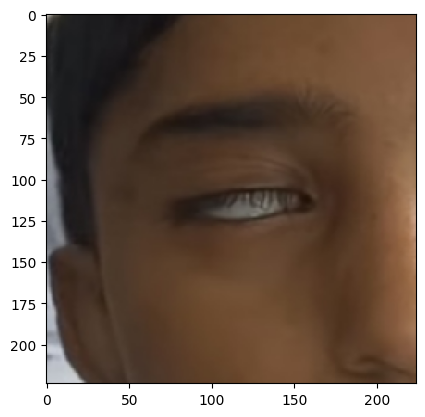

1/1 [==============================] - 3s 3s/step
0
Predicted Class: Lagophthalmos
Prediction Confidence: 0.173794224858284
Image Path testing\lagophthalmos\IMG_1821.PNG


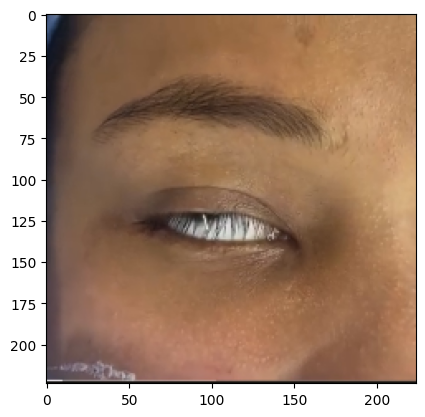

1/1 [==============================] - 0s 266ms/step
1
Predicted Class: Lagophthalmos
Prediction Confidence: 6.076290333112411e-07
Image Path testing\lagophthalmos\IMG_1822.PNG


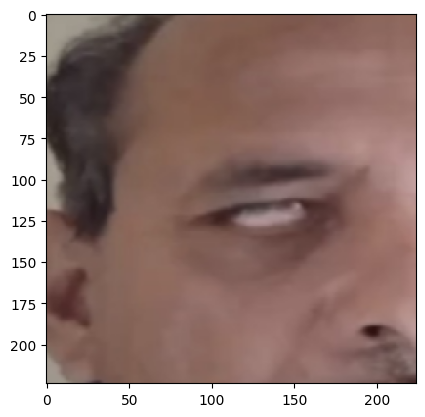

1/1 [==============================] - 0s 189ms/step
2
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0678231418132782
Image Path testing\lagophthalmos\IMG_1825.PNG


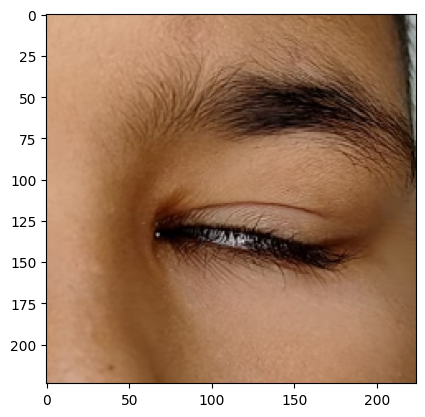

1/1 [==============================] - 0s 273ms/step
3
Predicted Class: Lagophthalmos
Prediction Confidence: 2.4139108489862338e-08
Image Path testing\lagophthalmos\IMG_1827.PNG


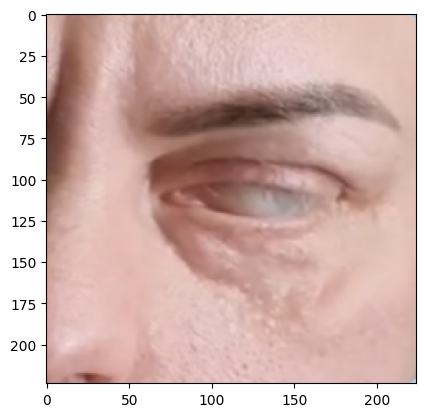

1/1 [==============================] - 0s 249ms/step
4
Predicted Class: Lagophthalmos
Prediction Confidence: 0.00014832957822363824
Image Path testing\lagophthalmos\IMG_1828.PNG


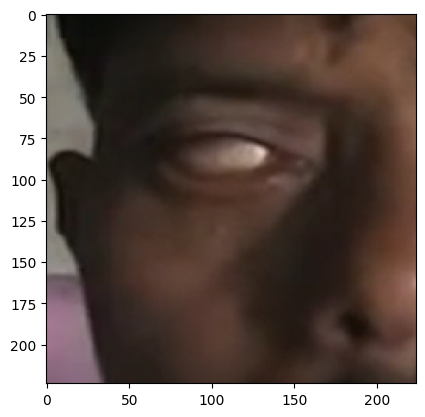

1/1 [==============================] - 0s 255ms/step
5
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0002851691679097712
Image Path testing\lagophthalmos\IMG_1831.JPG


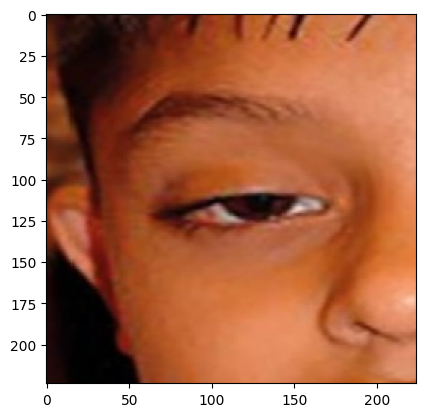

1/1 [==============================] - 0s 221ms/step
6
Predicted Class: Lagophthalmos
Prediction Confidence: 4.4132747234471026e-08
Image Path testing\lagophthalmos\IMG_1832.JPG


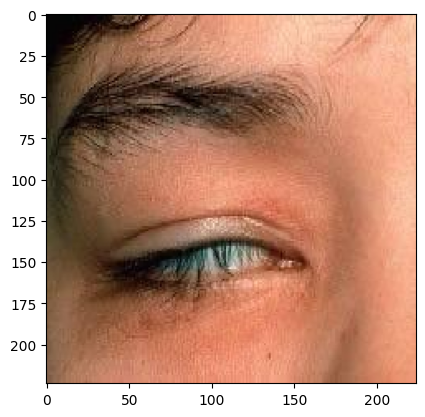

1/1 [==============================] - 0s 233ms/step
7
Predicted Class: Lagophthalmos
Prediction Confidence: 2.1334980715437268e-07
Image Path testing\lagophthalmos\IMG_1835.JPG


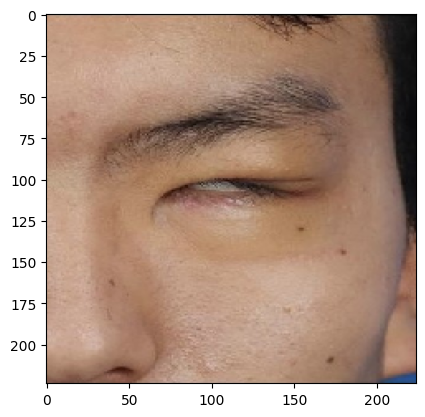

1/1 [==============================] - 0s 230ms/step
8
Predicted Class: Lagophthalmos
Prediction Confidence: 2.3805606375049138e-08
Image Path testing\lagophthalmos\IMG_2095.JPG


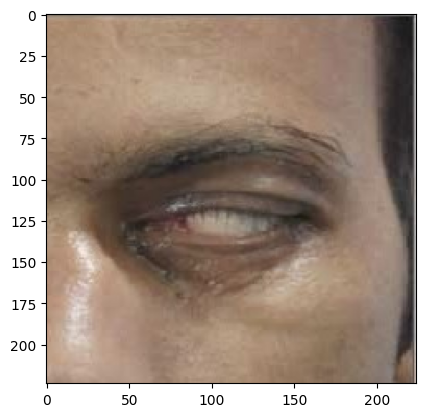

1/1 [==============================] - 0s 277ms/step
9
Predicted Class: Lagophthalmos
Prediction Confidence: 3.606751564078081e-09
Image Path testing\lagophthalmos\IMG_2099.JPG


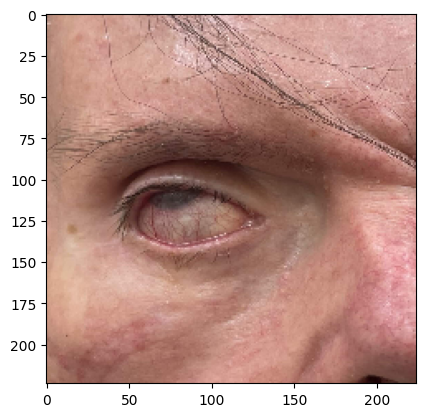

1/1 [==============================] - 0s 203ms/step
10
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0002807195414789021
Image Path testing\lagophthalmos\IMG_2100.PNG


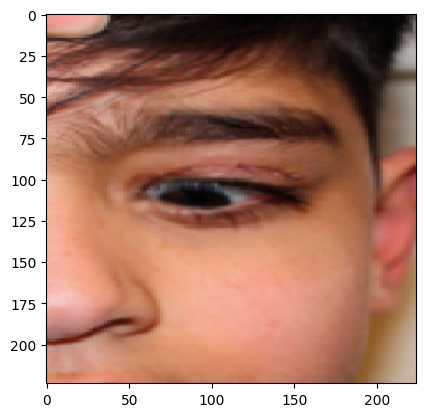

1/1 [==============================] - 0s 218ms/step
11
Predicted Class: Lagophthalmos
Prediction Confidence: 3.851302210478025e-08
Image Path testing\lagophthalmos\IMG_2101.JPG


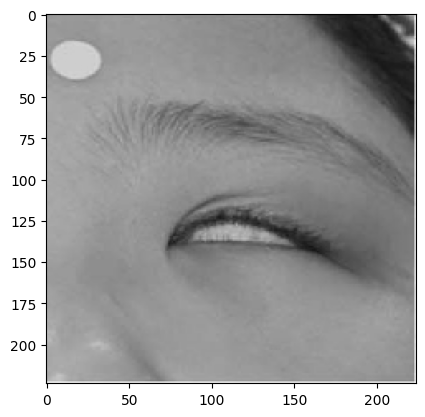

1/1 [==============================] - 0s 225ms/step
12
Predicted Class: Normal
Prediction Confidence: 0.5964269042015076
Image Path testing\lagophthalmos\IMG_3088.jpg


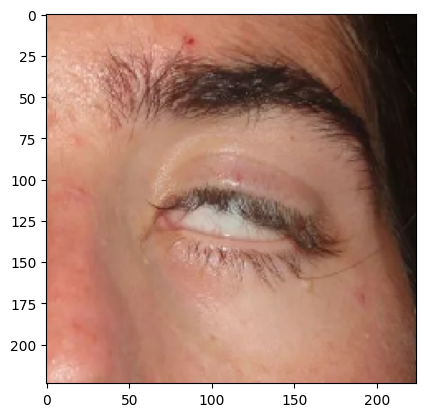

1/1 [==============================] - 0s 245ms/step
13
Predicted Class: Lagophthalmos
Prediction Confidence: 8.286897557052697e-11
Image Path testing\lagophthalmos\IMG_3102.jpeg


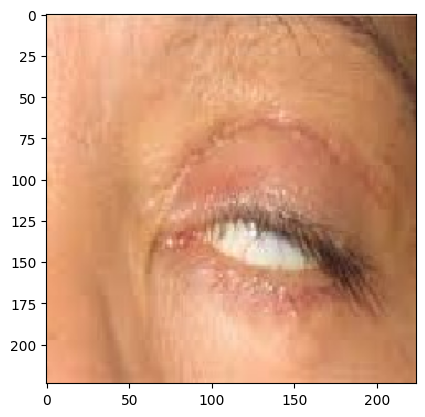

1/1 [==============================] - 0s 271ms/step
14
Predicted Class: Lagophthalmos
Prediction Confidence: 2.230462703423086e-09
Image Path testing\lagophthalmos\IMG_4583.png


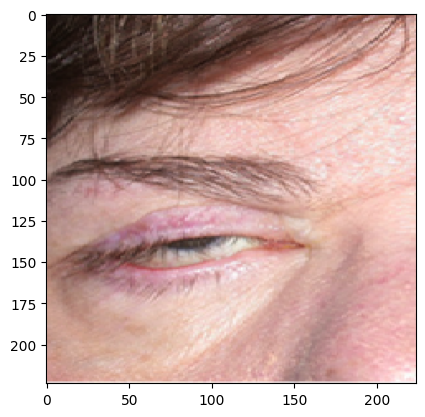

1/1 [==============================] - 0s 207ms/step
15
Predicted Class: Lagophthalmos
Prediction Confidence: 7.079896022332832e-05
Image Path testing\lagophthalmos\IMG_4593.jpg


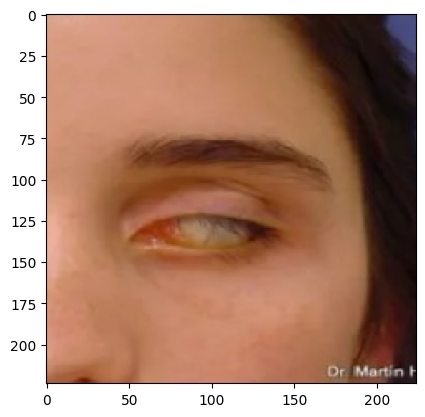

1/1 [==============================] - 0s 298ms/step
16
Predicted Class: Lagophthalmos
Prediction Confidence: 3.410587723351455e-08
Image Path testing\lagophthalmos\IMG_4621.jpg


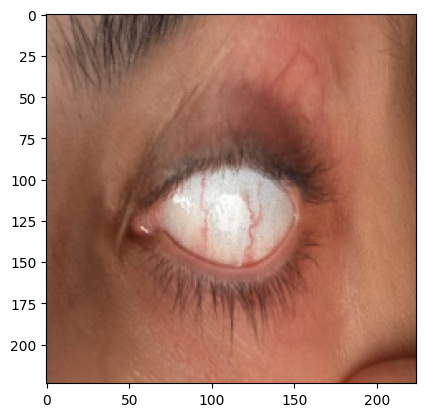

1/1 [==============================] - 0s 221ms/step
17
Predicted Class: Lagophthalmos
Prediction Confidence: 1.4917895896360278e-05
Image Path testing\lagophthalmos\IMG_4627.jpg


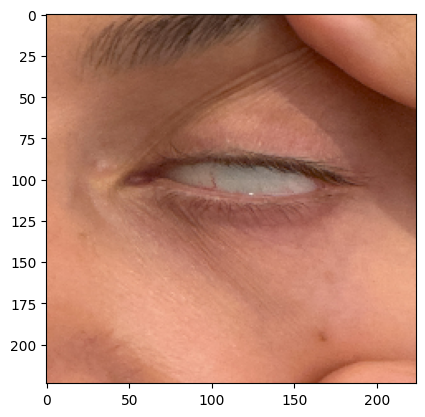

1/1 [==============================] - 0s 248ms/step
18
Predicted Class: Lagophthalmos
Prediction Confidence: 0.009057053364813328
Image Path testing\lagophthalmos\IMG_4628.jpg


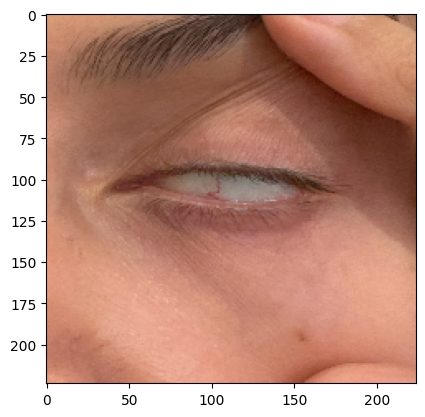

1/1 [==============================] - 0s 184ms/step
19
Predicted Class: Lagophthalmos
Prediction Confidence: 6.981995102250949e-05
Image Path testing\lagophthalmos\IMG_4629.jpg


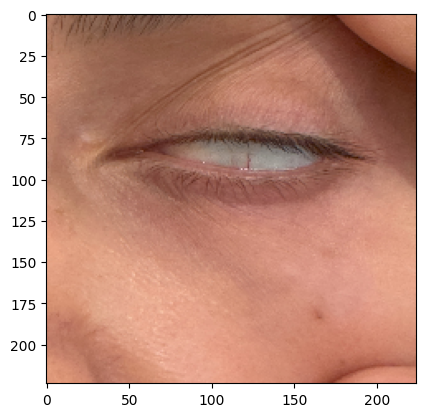

1/1 [==============================] - 0s 248ms/step
20
Predicted Class: Lagophthalmos
Prediction Confidence: 0.003585707861930132
Image Path testing\lagophthalmos\IMG_4630.jpg


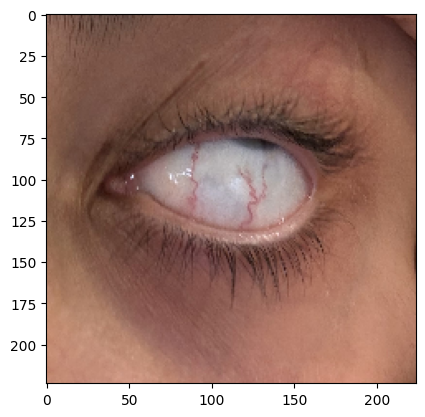

1/1 [==============================] - 0s 280ms/step
21
Predicted Class: Lagophthalmos
Prediction Confidence: 0.00017369231500197202
Image Path testing\lagophthalmos\IMG_4631.jpg


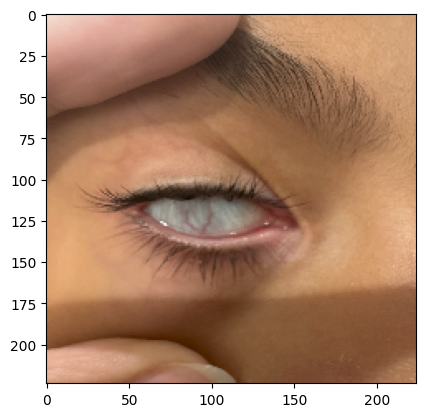

1/1 [==============================] - 0s 289ms/step
22
Predicted Class: Lagophthalmos
Prediction Confidence: 1.0494325579202268e-05
Image Path testing\lagophthalmos\IMG_4633.jpg


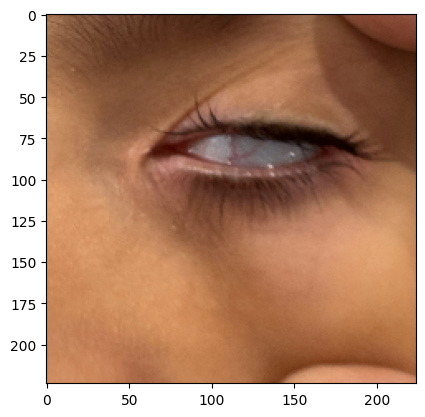

1/1 [==============================] - 0s 283ms/step
23
Predicted Class: Lagophthalmos
Prediction Confidence: 2.0260126802895684e-06
Image Path testing\lagophthalmos\IMG_4634.jpg


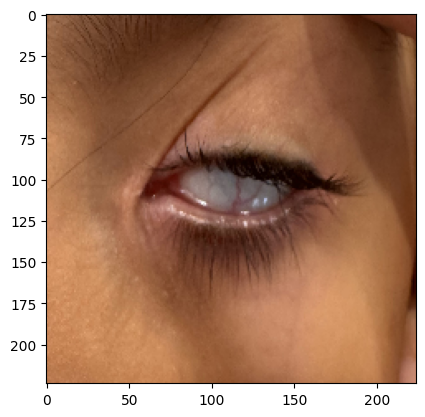

1/1 [==============================] - 0s 212ms/step
24
Predicted Class: Lagophthalmos
Prediction Confidence: 1.0852062304333998e-11
Image Path testing\lagophthalmos\IMG_4635.jpg


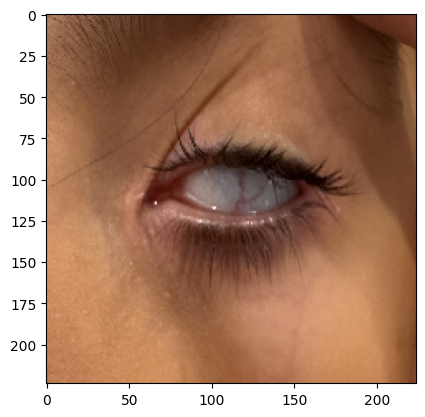

1/1 [==============================] - 0s 200ms/step
25
Predicted Class: Lagophthalmos
Prediction Confidence: 1.5167066491628134e-09
Image Path testing\lagophthalmos\IMG_4636.jpg


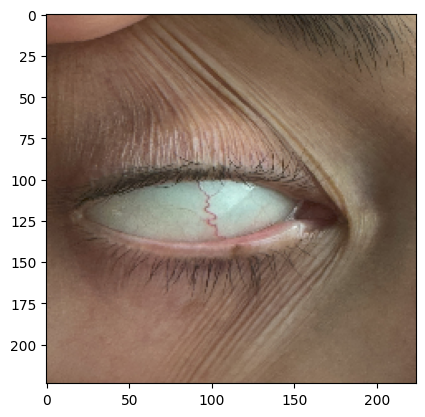

1/1 [==============================] - 0s 306ms/step
26
Predicted Class: Normal
Prediction Confidence: 0.7424817085266113
Image Path testing\lagophthalmos\IMG_4637.jpg


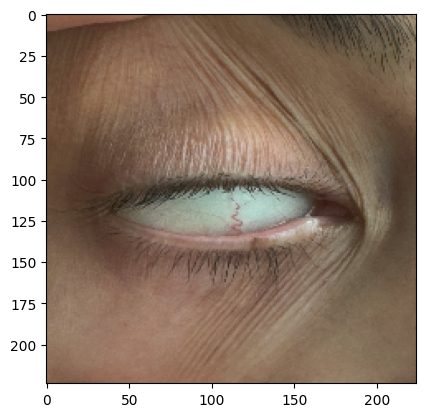

1/1 [==============================] - 0s 227ms/step
27
Predicted Class: Lagophthalmos
Prediction Confidence: 0.4434776306152344
Image Path testing\lagophthalmos\IMG_4638.jpg


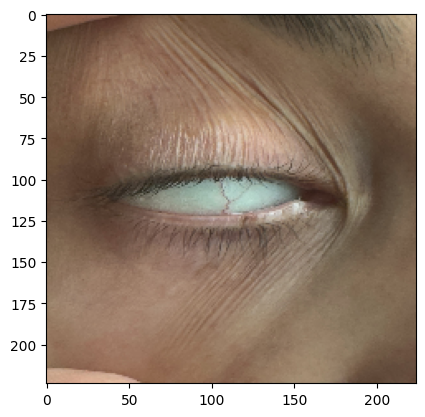

1/1 [==============================] - 0s 241ms/step
28
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0001779294543666765
Image Path testing\lagophthalmos\IMG_4899.PNG


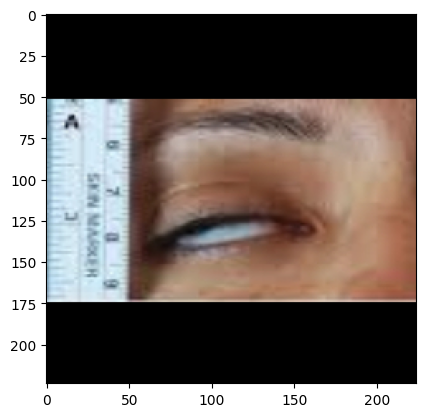

1/1 [==============================] - 0s 228ms/step
29
Predicted Class: Lagophthalmos
Prediction Confidence: 0.05143997073173523
Image Path testing\lagophthalmos\IMG_4900.PNG


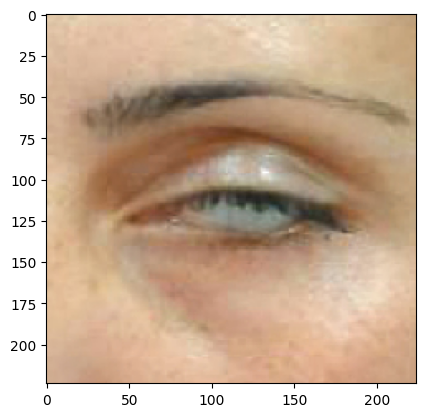

1/1 [==============================] - 0s 228ms/step
30
Predicted Class: Lagophthalmos
Prediction Confidence: 6.232942162398558e-09
Image Path testing\lagophthalmos\IMG_4901.PNG


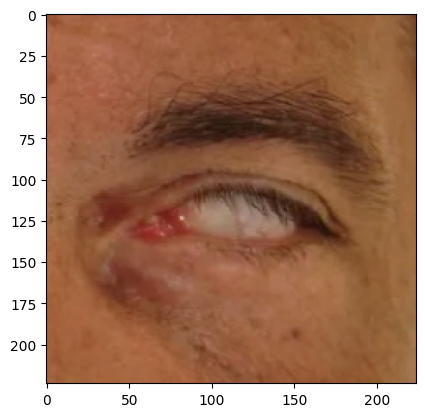

1/1 [==============================] - 0s 251ms/step
31
Predicted Class: Lagophthalmos
Prediction Confidence: 2.2182948811177994e-09
Image Path testing\lagophthalmos\IMG_4903.PNG


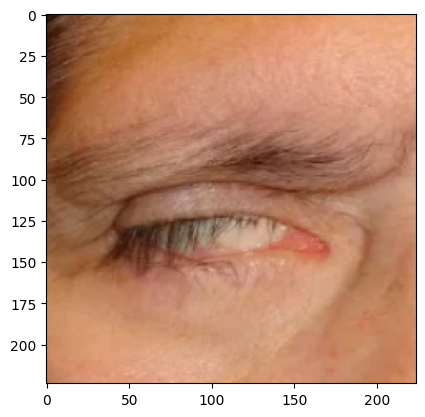

1/1 [==============================] - 0s 223ms/step
32
Predicted Class: Lagophthalmos
Prediction Confidence: 3.618610935518518e-05
Image Path testing\lagophthalmos\IMG_4904.PNG


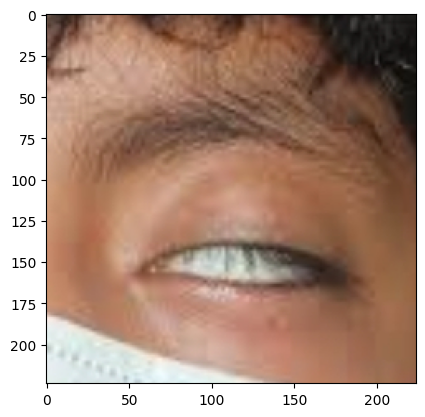

1/1 [==============================] - 0s 232ms/step
33
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0003134248545393348
Image Path testing\lagophthalmos\IMG_4905.PNG


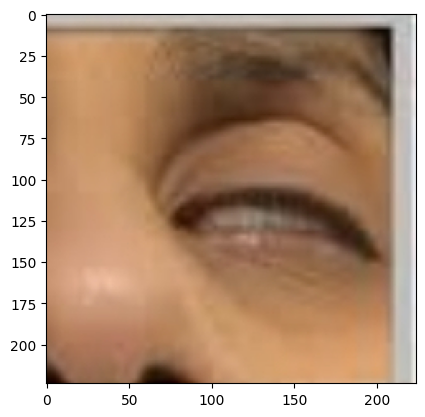

1/1 [==============================] - 0s 243ms/step
34
Predicted Class: Lagophthalmos
Prediction Confidence: 5.966424578218721e-05
Image Path testing\lagophthalmos\IMG_4906.PNG


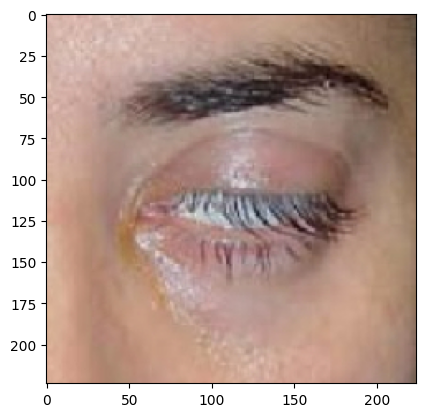

1/1 [==============================] - 0s 224ms/step
35
Predicted Class: Normal
Prediction Confidence: 0.7195234894752502
Image Path testing\lagophthalmos\IMG_4907.PNG


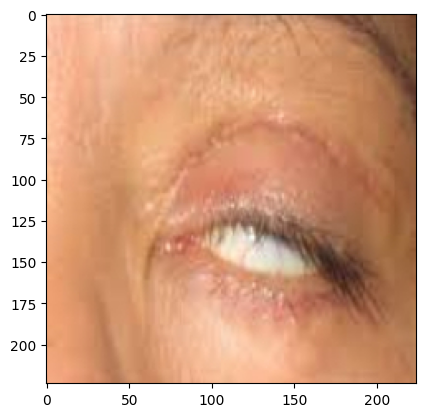

1/1 [==============================] - 0s 250ms/step
36
Predicted Class: Lagophthalmos
Prediction Confidence: 1.6193439478229266e-08
Image Path testing\lagophthalmos\IMG_4908.PNG


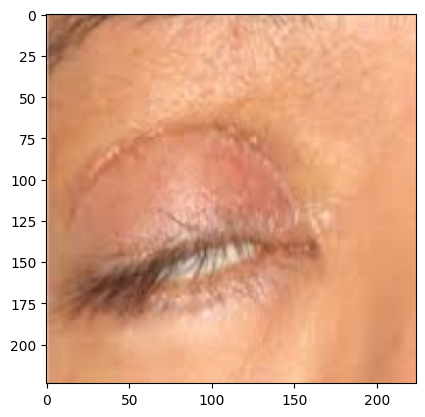

1/1 [==============================] - 0s 162ms/step
37
Predicted Class: Lagophthalmos
Prediction Confidence: 0.34520235657691956
Image Path testing\lagophthalmos\IMG_4909.PNG


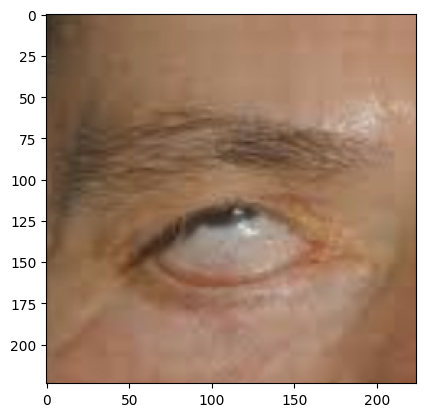

1/1 [==============================] - 0s 148ms/step
38
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0733872726559639
Image Path testing\lagophthalmos\IMG_4911.PNG


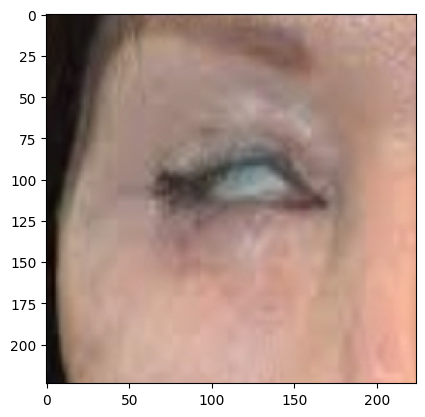

1/1 [==============================] - 0s 212ms/step
39
Predicted Class: Lagophthalmos
Prediction Confidence: 5.642796168103814e-07
Image Path testing\lagophthalmos\IMG_4912.PNG


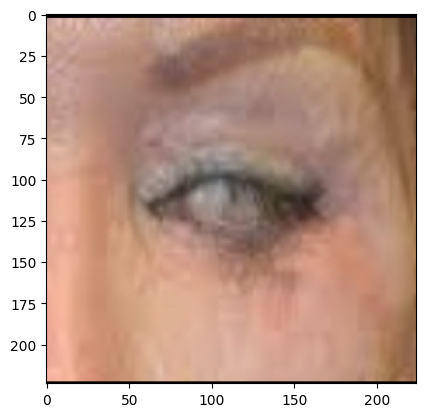

1/1 [==============================] - 0s 207ms/step
40
Predicted Class: Lagophthalmos
Prediction Confidence: 3.5891685001843143e-07
Image Path testing\lagophthalmos\IMG_4913.PNG


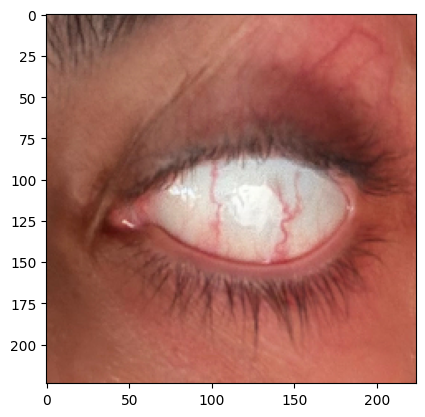

1/1 [==============================] - 0s 251ms/step
41
Predicted Class: Lagophthalmos
Prediction Confidence: 0.029196735471487045
Image Path testing\lagophthalmos\IMG_4914.PNG


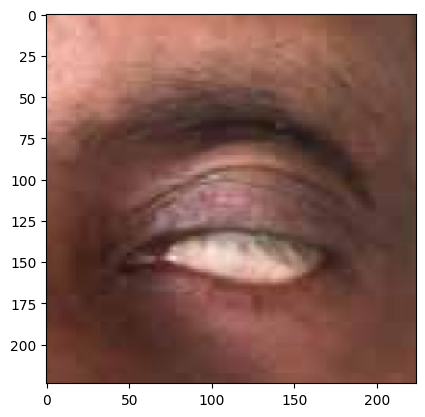

1/1 [==============================] - 0s 260ms/step
42
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0005776442703790963
Image Path testing\lagophthalmos\IMG_4920.jpeg


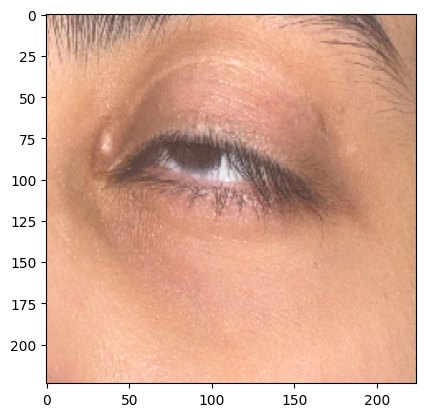

1/1 [==============================] - 0s 248ms/step
43
Predicted Class: Lagophthalmos
Prediction Confidence: 2.718935493417618e-11
Image Path testing\lagophthalmos\IMG_4922.jpg


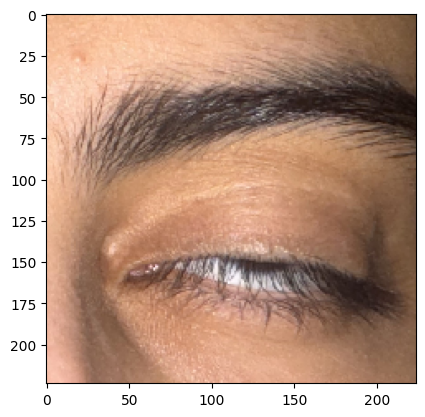

1/1 [==============================] - 0s 269ms/step
44
Predicted Class: Lagophthalmos
Prediction Confidence: 3.5128075523971347e-06
Image Path testing\lagophthalmos\IMG_4923.jpg


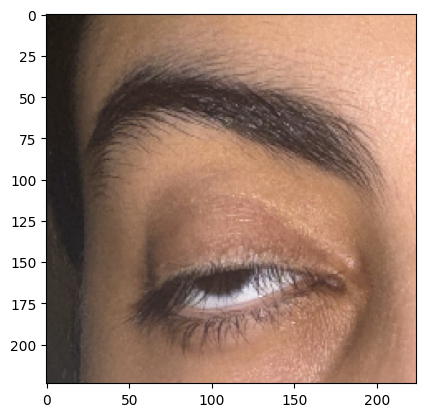

1/1 [==============================] - 0s 236ms/step
45
Predicted Class: Lagophthalmos
Prediction Confidence: 7.710294994467404e-06
Image Path testing\lagophthalmos\IMG_4926.jpg


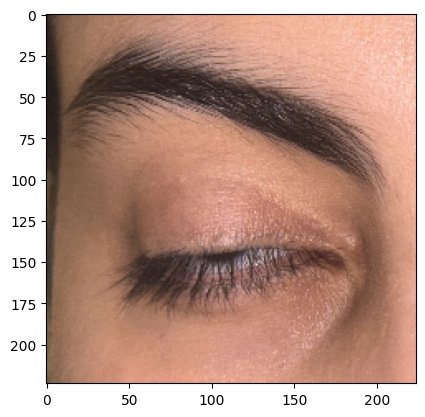

1/1 [==============================] - 0s 218ms/step
46
Predicted Class: Lagophthalmos
Prediction Confidence: 6.129974644863978e-05
Image Path testing\lagophthalmos\IMG_4927.jpg


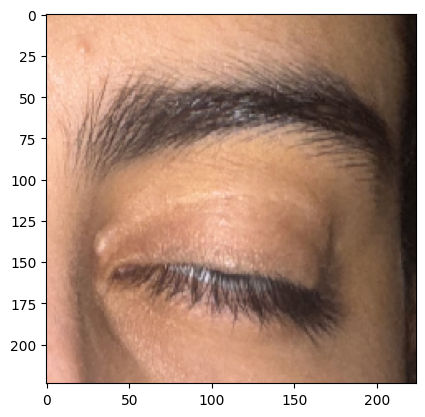

1/1 [==============================] - 0s 177ms/step
47
Predicted Class: Lagophthalmos
Prediction Confidence: 2.0383060927997576e-07
Image Path testing\lagophthalmos\IMG_4928.jpg


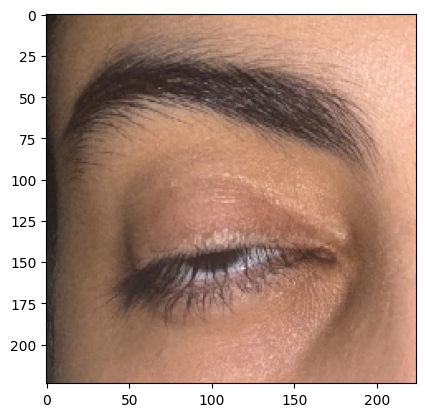

1/1 [==============================] - 0s 249ms/step
48
Predicted Class: Lagophthalmos
Prediction Confidence: 7.042303309390263e-07
Image Path testing\lagophthalmos\IMG_4929.jpg


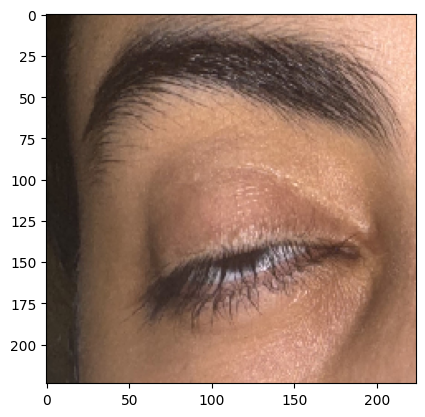

1/1 [==============================] - 0s 286ms/step
49
Predicted Class: Lagophthalmos
Prediction Confidence: 3.3644013797129446e-07
Image Path testing\lagophthalmos\IMG_4938.jpg


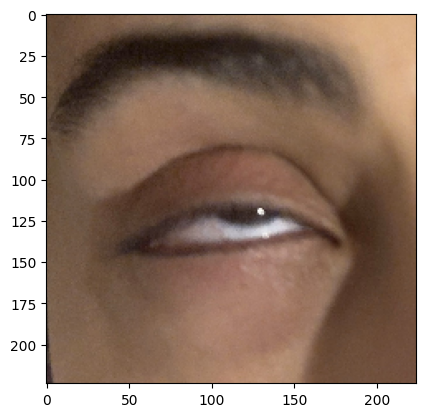

1/1 [==============================] - 0s 217ms/step
50
Predicted Class: Lagophthalmos
Prediction Confidence: 1.9960561203902216e-08
Image Path testing\lagophthalmos\IMG_4939.jpg


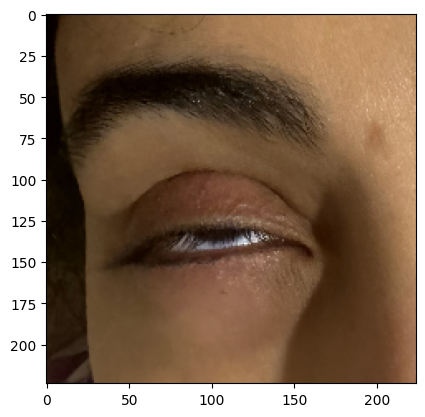

1/1 [==============================] - 0s 250ms/step
51
Predicted Class: Lagophthalmos
Prediction Confidence: 2.352086994505953e-06
Image Path testing\lagophthalmos\IMG_4940.jpg


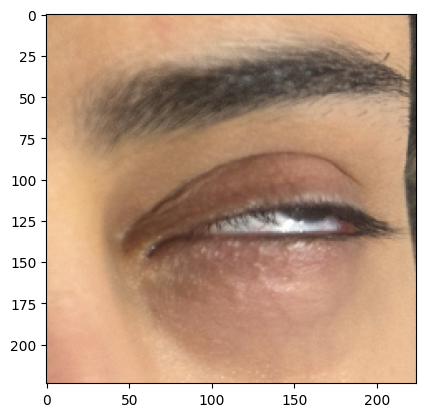

1/1 [==============================] - 0s 234ms/step
52
Predicted Class: Lagophthalmos
Prediction Confidence: 7.274898621290049e-07
Image Path testing\lagophthalmos\IMG_4946.jpg


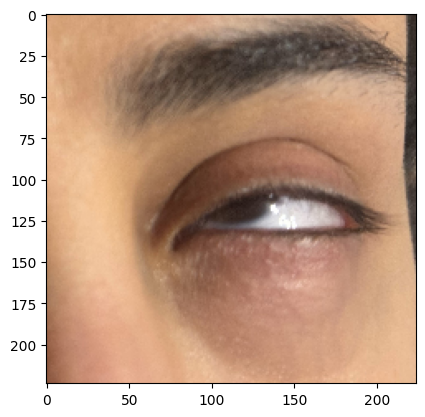

1/1 [==============================] - 0s 241ms/step
53
Predicted Class: Lagophthalmos
Prediction Confidence: 1.0512213322044772e-09
Image Path testing\lagophthalmos\IMG_4947.jpg


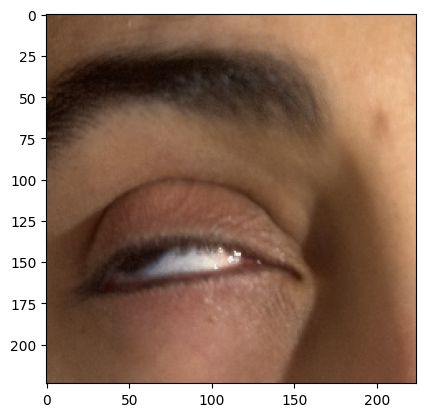

1/1 [==============================] - 0s 149ms/step
54
Predicted Class: Lagophthalmos
Prediction Confidence: 1.5858329788898118e-05
Image Path testing\lagophthalmos\IMG_4949.PNG


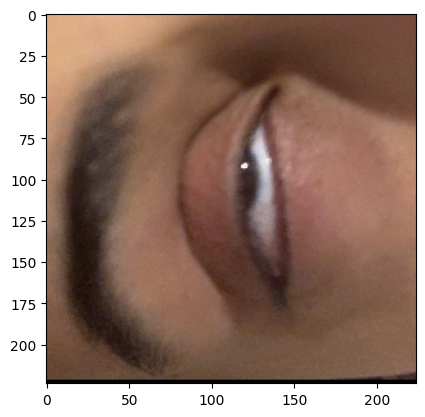

1/1 [==============================] - 0s 234ms/step
55
Predicted Class: Lagophthalmos
Prediction Confidence: 0.06488469988107681
Image Path testing\lagophthalmos\IMG_4997.PNG


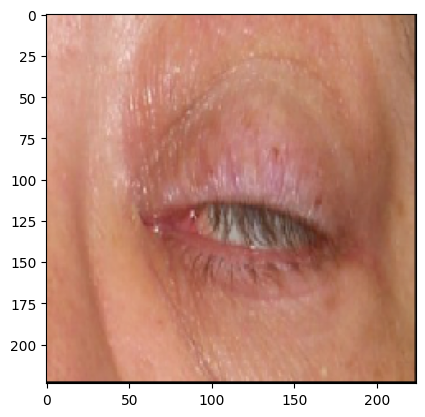

1/1 [==============================] - 0s 261ms/step
56
Predicted Class: Lagophthalmos
Prediction Confidence: 2.1033311981000224e-08
Image Path testing\lagophthalmos\IMG_5146.jpg


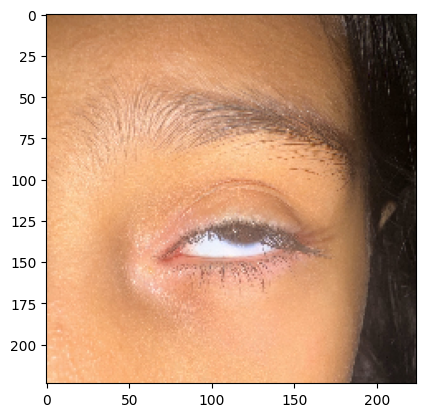

1/1 [==============================] - 0s 272ms/step
57
Predicted Class: Lagophthalmos
Prediction Confidence: 2.2105317576404104e-09
Image Path testing\lagophthalmos\IMG_5153.PNG


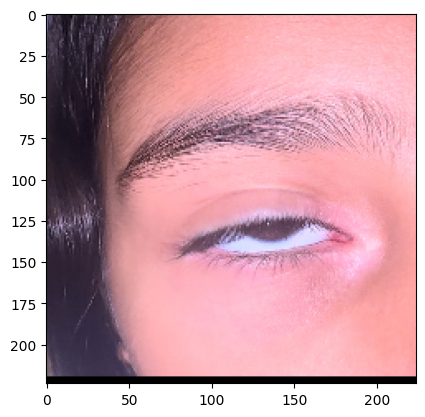

1/1 [==============================] - 0s 251ms/step
58
Predicted Class: Lagophthalmos
Prediction Confidence: 7.169250602601096e-05
Image Path testing\lagophthalmos\IMG_5165.jpg


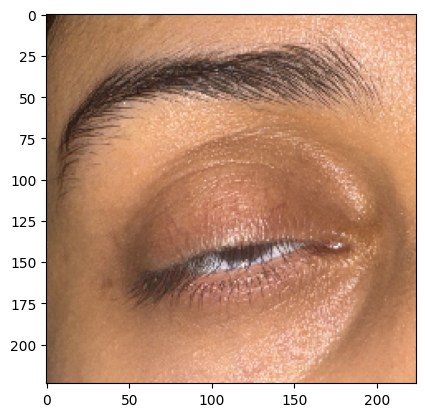

1/1 [==============================] - 0s 234ms/step
59
Predicted Class: Lagophthalmos
Prediction Confidence: 1.0316766463347449e-07
Image Path testing\lagophthalmos\IMG_5170.jpg


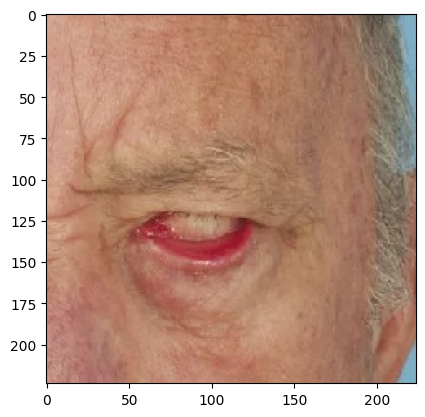

1/1 [==============================] - 0s 231ms/step
60
Predicted Class: Lagophthalmos
Prediction Confidence: 2.9984593652443436e-07
Image Path testing\lagophthalmos\IMG_5173.JPG


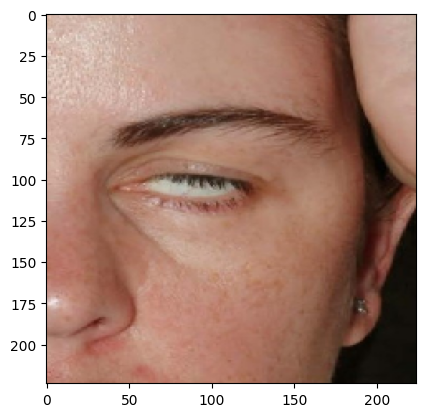

1/1 [==============================] - 0s 259ms/step
61
Predicted Class: Lagophthalmos
Prediction Confidence: 8.04051314418075e-09
Image Path testing\lagophthalmos\IMG_5175.JPG


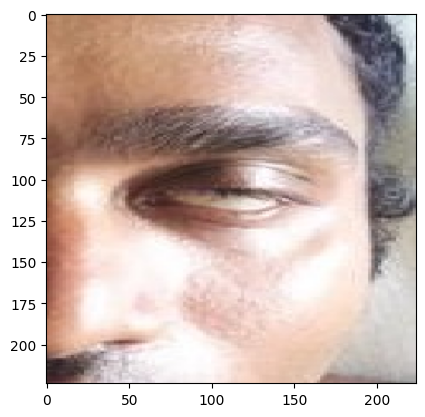

1/1 [==============================] - 0s 251ms/step
62
Predicted Class: Lagophthalmos
Prediction Confidence: 1.333560931016109e-06
Image Path testing\lagophthalmos\IMG_5176.JPG


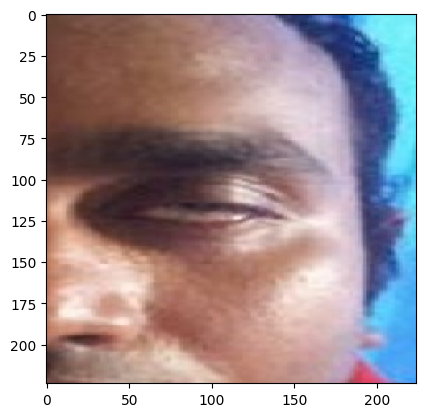

1/1 [==============================] - 0s 267ms/step
63
Predicted Class: Lagophthalmos
Prediction Confidence: 0.00023941414838191122
Image Path testing\lagophthalmos\IMG_5179.PNG


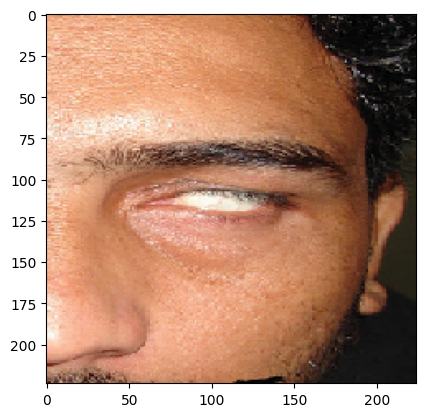

1/1 [==============================] - 0s 184ms/step
64
Predicted Class: Lagophthalmos
Prediction Confidence: 3.208015408873166e-09
Image Path testing\lagophthalmos\IMG_5180.PNG


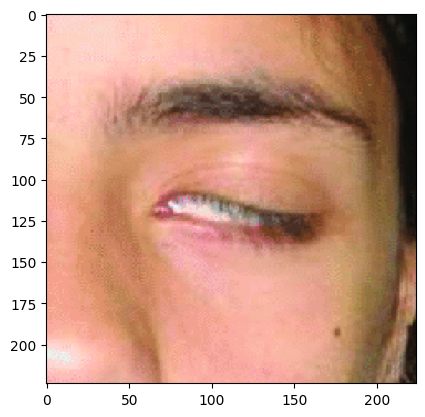

1/1 [==============================] - 0s 201ms/step
65
Predicted Class: Lagophthalmos
Prediction Confidence: 2.2430984847332525e-10
Image Path testing\lagophthalmos\IMG_5181.PNG


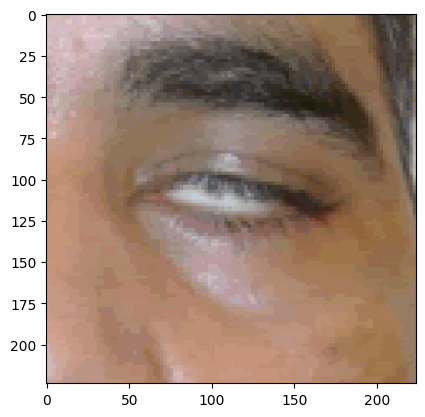

1/1 [==============================] - 0s 182ms/step
66
Predicted Class: Lagophthalmos
Prediction Confidence: 7.52936657466563e-10
Image Path testing\lagophthalmos\IMG_5210.PNG


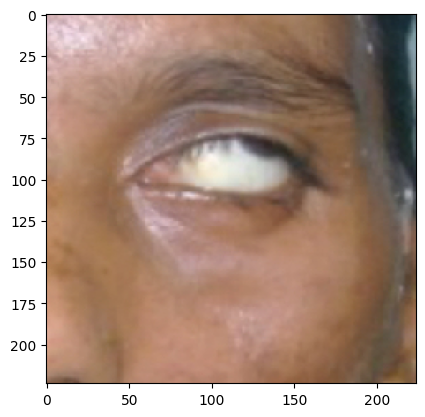

1/1 [==============================] - 0s 300ms/step
67
Predicted Class: Lagophthalmos
Prediction Confidence: 8.853037414269238e-09
Image Path testing\lagophthalmos\IMG_5211.PNG


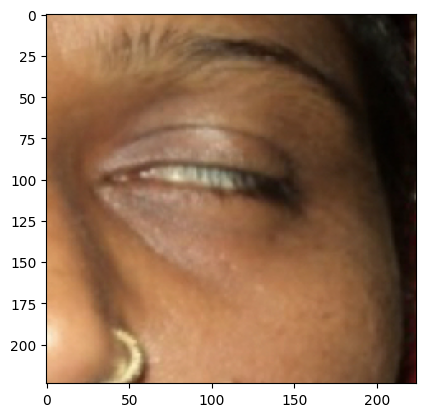

1/1 [==============================] - 0s 268ms/step
68
Predicted Class: Lagophthalmos
Prediction Confidence: 1.367681790043207e-07
Image Path testing\lagophthalmos\IMG_5212.PNG


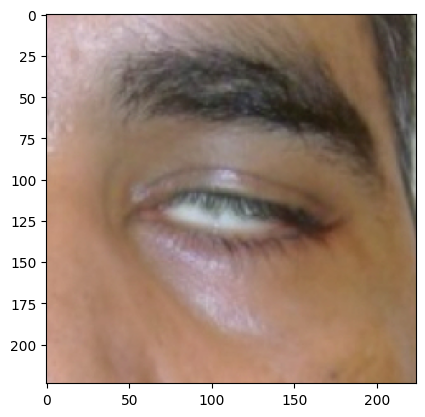

1/1 [==============================] - 0s 265ms/step
69
Predicted Class: Lagophthalmos
Prediction Confidence: 1.1660359788834285e-08
Image Path testing\lagophthalmos\IMG_5213.PNG


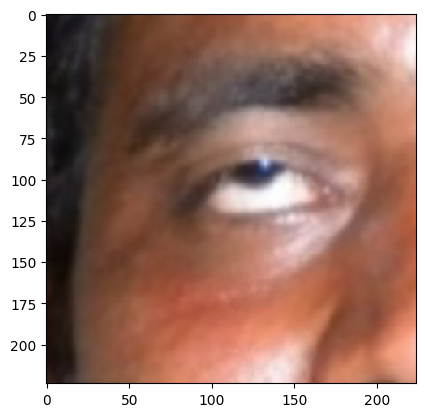

1/1 [==============================] - 0s 234ms/step
70
Predicted Class: Lagophthalmos
Prediction Confidence: 1.1318974202367826e-08
Image Path testing\lagophthalmos\IMG_5214.PNG


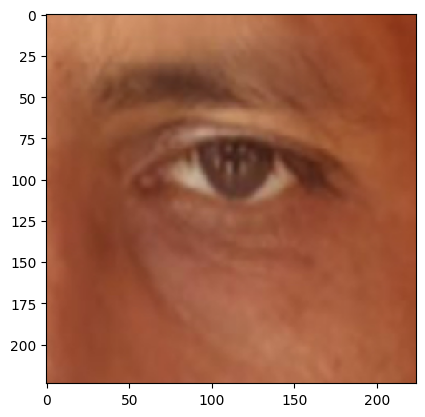

1/1 [==============================] - 0s 283ms/step
71
Predicted Class: Lagophthalmos
Prediction Confidence: 6.967384251765907e-06
Image Path testing\lagophthalmos\IMG_5217.PNG


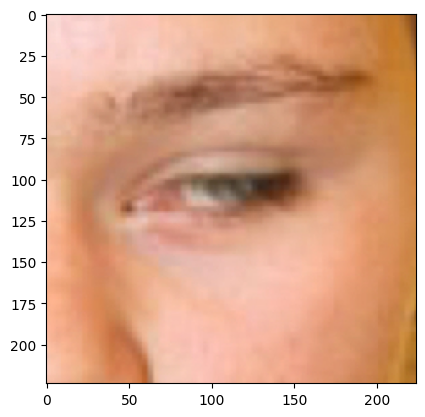

1/1 [==============================] - 0s 183ms/step
72
Predicted Class: Lagophthalmos
Prediction Confidence: 1.4309725848704602e-08
Image Path testing\lagophthalmos\IMG_5220.PNG


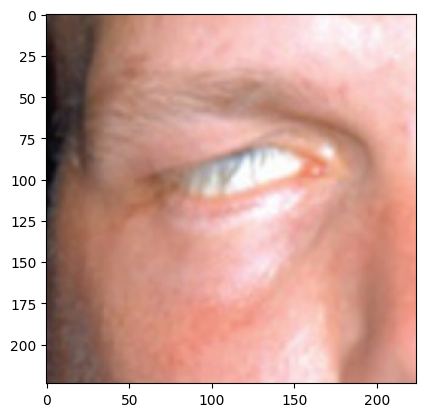

1/1 [==============================] - 0s 250ms/step
73
Predicted Class: Lagophthalmos
Prediction Confidence: 1.3602680759561281e-08
Image Path testing\lagophthalmos\IMG_5222.PNG


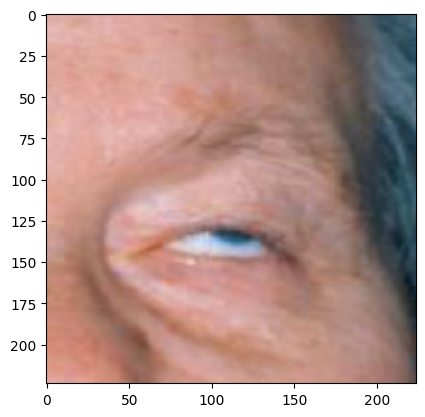

1/1 [==============================] - 0s 232ms/step
74
Predicted Class: Lagophthalmos
Prediction Confidence: 9.927024393618922e-07
Image Path testing\lagophthalmos\IMG_5223.PNG


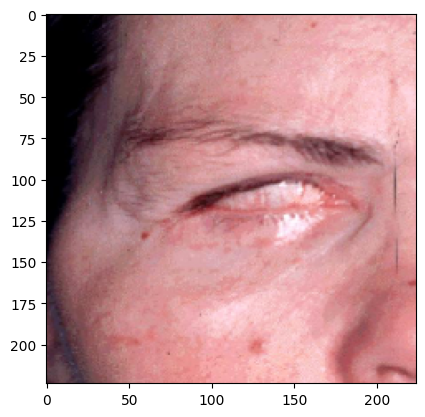

1/1 [==============================] - 0s 230ms/step
75
Predicted Class: Lagophthalmos
Prediction Confidence: 8.712288945389446e-06
Image Path testing\lagophthalmos\IMG_5224.PNG


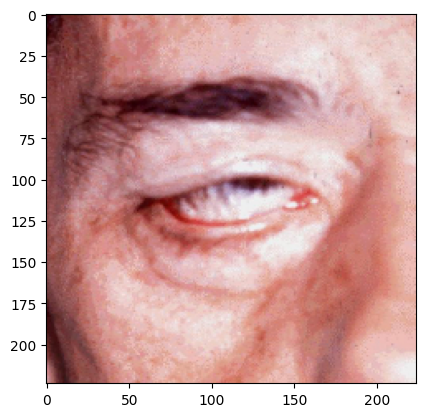

1/1 [==============================] - 0s 292ms/step
76
Predicted Class: Lagophthalmos
Prediction Confidence: 1.4973161599485252e-09
Image Path testing\lagophthalmos\IMG_5225.PNG


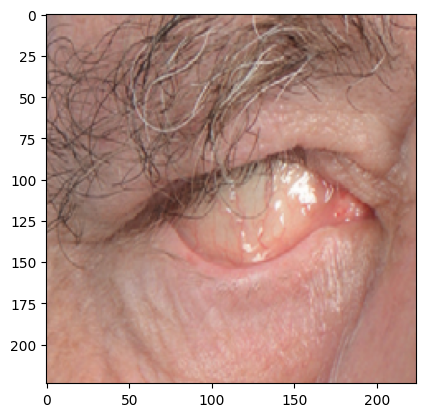

1/1 [==============================] - 0s 290ms/step
77
Predicted Class: Lagophthalmos
Prediction Confidence: 8.152942609740421e-05
Image Path testing\lagophthalmos\IMG_5226.PNG


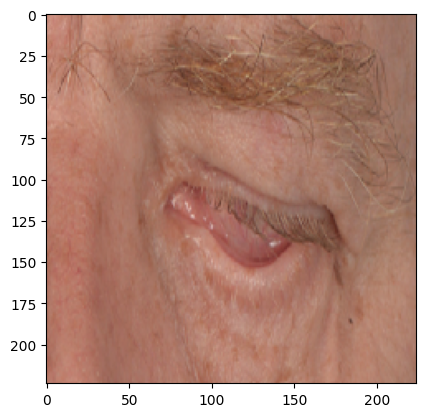

1/1 [==============================] - 0s 218ms/step
78
Predicted Class: Normal
Prediction Confidence: 0.9988513588905334
Image Path testing\lagophthalmos\IMG_5231.JPG


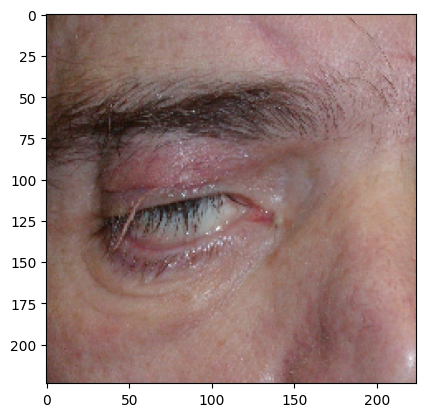

1/1 [==============================] - 0s 249ms/step
79
Predicted Class: Lagophthalmos
Prediction Confidence: 1.1884445427767787e-08
Image Path testing\lagophthalmos\IMG_5236.jpeg


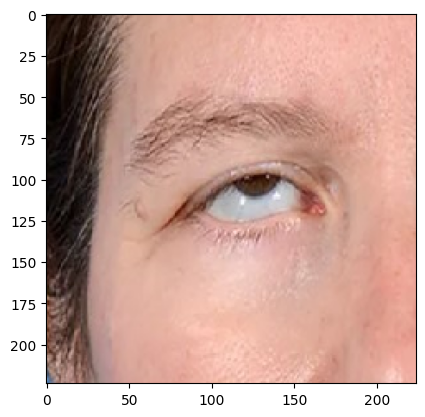

1/1 [==============================] - 0s 282ms/step
80
Predicted Class: Lagophthalmos
Prediction Confidence: 2.4575813606375618e-11
Image Path testing\lagophthalmos\IMG_5237.JPG


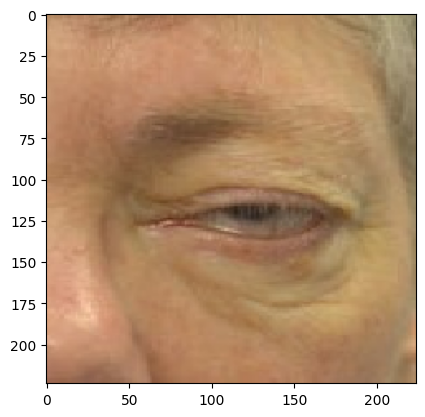

1/1 [==============================] - 0s 250ms/step
81
Predicted Class: Lagophthalmos
Prediction Confidence: 1.8398446854916983e-07
Image Path testing\lagophthalmos\IMG_5238.JPG


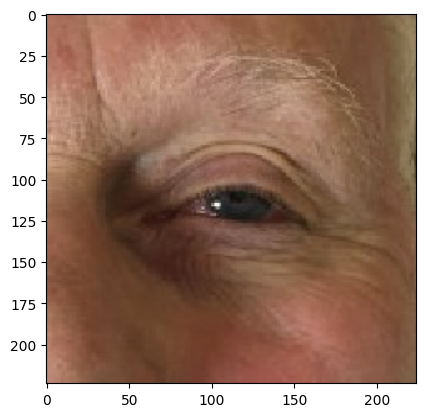

1/1 [==============================] - 0s 232ms/step
82
Predicted Class: Lagophthalmos
Prediction Confidence: 9.044969218052756e-09
Image Path testing\lagophthalmos\IMG_5239.PNG


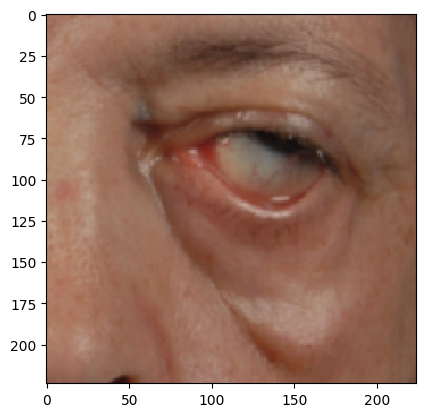

1/1 [==============================] - 0s 249ms/step
83
Predicted Class: Lagophthalmos
Prediction Confidence: 4.2836241220811644e-08
Image Path testing\lagophthalmos\IMG_5241.PNG


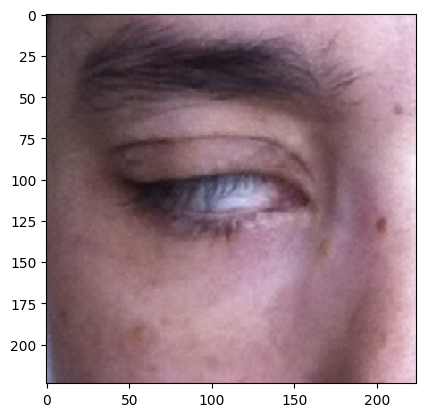

1/1 [==============================] - 0s 198ms/step
84
Predicted Class: Lagophthalmos
Prediction Confidence: 7.289981063252071e-09
Image Path testing\lagophthalmos\IMG_5242.JPG


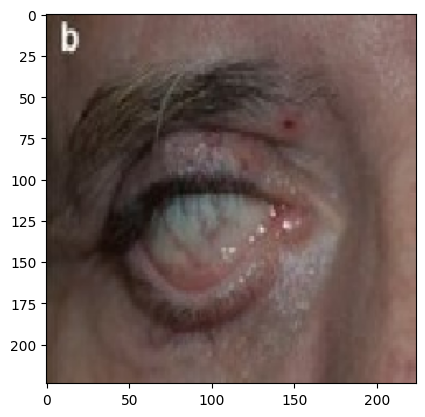

1/1 [==============================] - 0s 200ms/step
85
Predicted Class: Lagophthalmos
Prediction Confidence: 1.9969135678366e-07
Image Path testing\lagophthalmos\IMG_5248.PNG


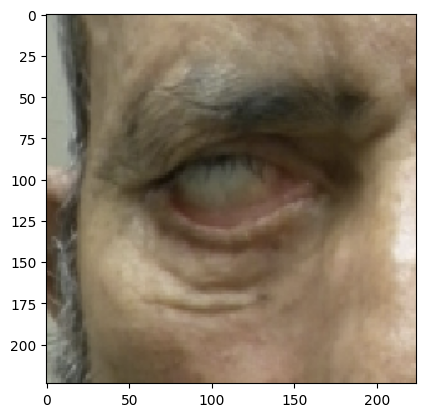

1/1 [==============================] - 0s 217ms/step
86
Predicted Class: Normal
Prediction Confidence: 0.9299489259719849
Image Path testing\lagophthalmos\IMG_5249.JPG


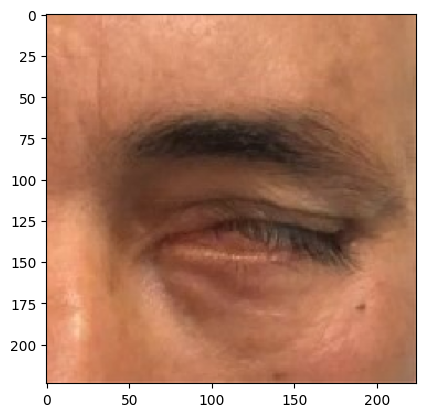

1/1 [==============================] - 0s 249ms/step
87
Predicted Class: Lagophthalmos
Prediction Confidence: 5.517786485143006e-05
Image Path testing\lagophthalmos\IMG_5250.JPG


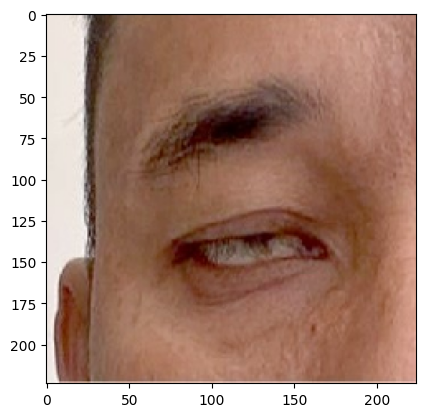

1/1 [==============================] - 0s 250ms/step
88
Predicted Class: Lagophthalmos
Prediction Confidence: 9.381325938306873e-09
Image Path testing\lagophthalmos\IMG_5252.JPG


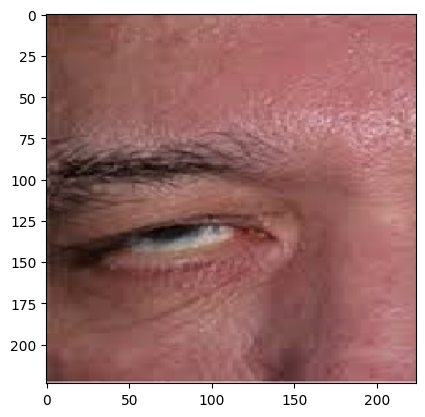

1/1 [==============================] - 0s 250ms/step
89
Predicted Class: Normal
Prediction Confidence: 0.9986588954925537
Image Path testing\lagophthalmos\IMG_7909.JPG


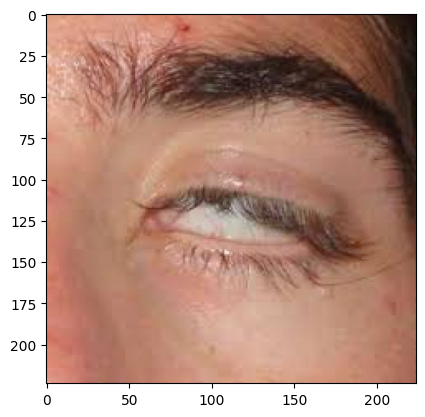

1/1 [==============================] - 0s 247ms/step
90
Predicted Class: Lagophthalmos
Prediction Confidence: 6.953312237101272e-08
Image Path testing\lagophthalmos\IMG_7914.JPG


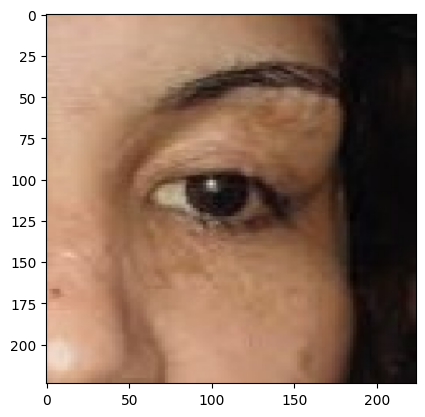

1/1 [==============================] - 0s 199ms/step
91
Predicted Class: Lagophthalmos
Prediction Confidence: 5.4107877900388957e-11
Image Path testing\lagophthalmos\IMG_7915.JPG


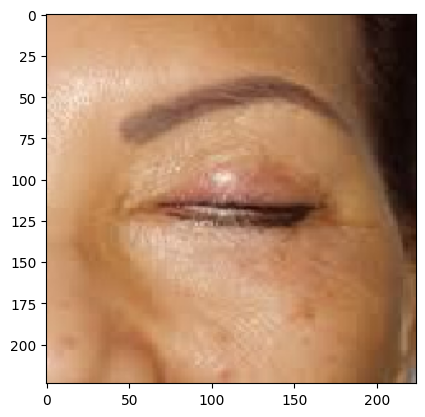

1/1 [==============================] - 0s 234ms/step
92
Predicted Class: Lagophthalmos
Prediction Confidence: 1.7326199142075893e-08
Image Path testing\lagophthalmos\test1.jpeg


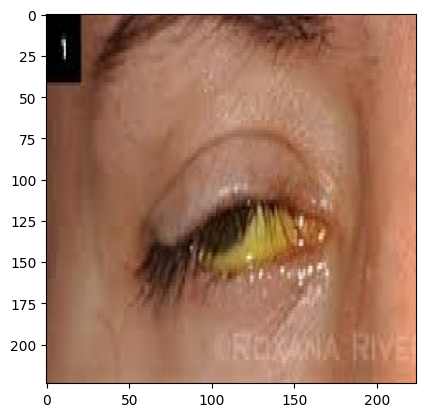

1/1 [==============================] - 0s 188ms/step
93
Predicted Class: Lagophthalmos
Prediction Confidence: 5.931937607783766e-09
Image Path testing\lagophthalmos\test10.PNG


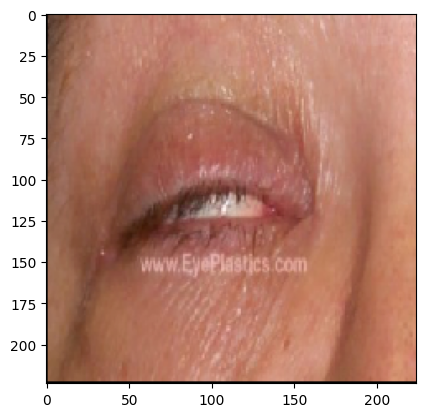

1/1 [==============================] - 0s 173ms/step
94
Predicted Class: Lagophthalmos
Prediction Confidence: 3.5095104976790026e-05
Image Path testing\lagophthalmos\test2.jpeg


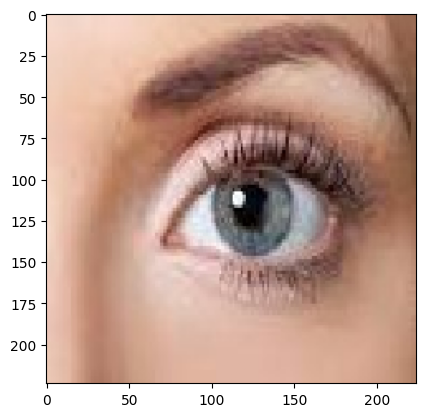

1/1 [==============================] - 0s 269ms/step
95
Predicted Class: Lagophthalmos
Prediction Confidence: 1.339156563417987e-11
Image Path testing\lagophthalmos\test6.jpg


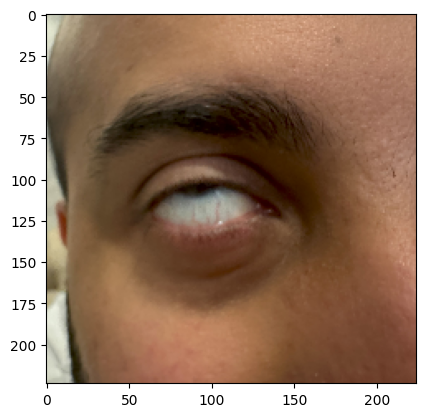

1/1 [==============================] - 0s 217ms/step
96
Predicted Class: Lagophthalmos
Prediction Confidence: 3.4569003215523253e-10
Image Path testing\lagophthalmos\test7.jpg


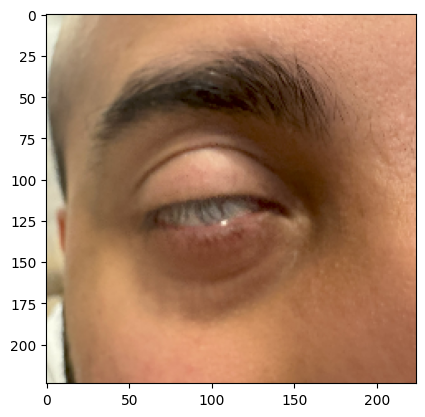

1/1 [==============================] - 0s 249ms/step
97
Predicted Class: Lagophthalmos
Prediction Confidence: 5.406929071138933e-11
Image Path testing\lagophthalmos\test8.jpg


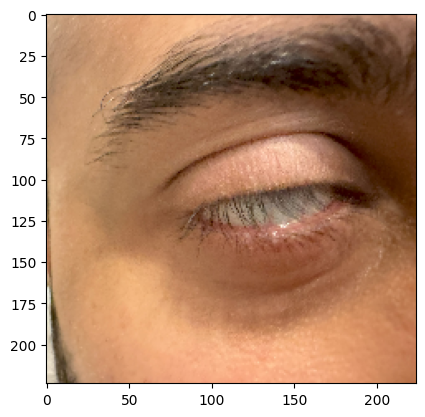

1/1 [==============================] - 0s 262ms/step
98
Predicted Class: Lagophthalmos
Prediction Confidence: 1.6300745198094546e-09
Image Path testing\normal\Ali_closed_1.jpg


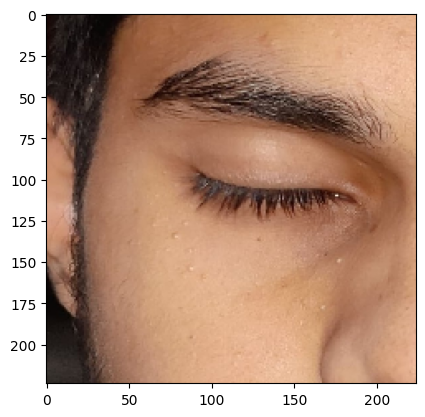

1/1 [==============================] - 0s 300ms/step
99
Predicted Class: Lagophthalmos
Prediction Confidence: 3.452914540957863e-07
Image Path testing\normal\Ali_closed_2.jpg


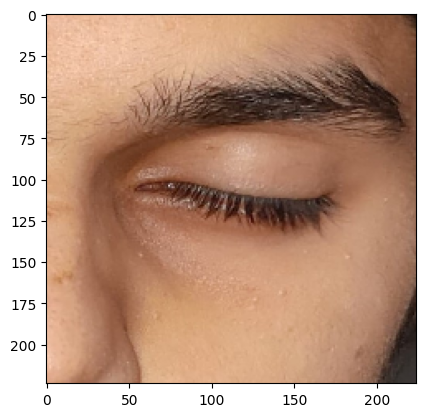

1/1 [==============================] - 0s 205ms/step
100
Predicted Class: Lagophthalmos
Prediction Confidence: 1.152371531532026e-09
Image Path testing\normal\IMG_3088.jpg


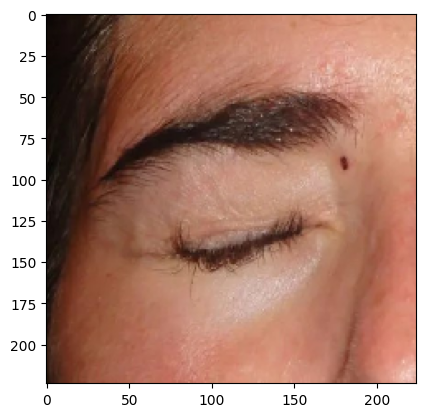

1/1 [==============================] - 0s 150ms/step
101
Predicted Class: Lagophthalmos
Prediction Confidence: 8.117668039631099e-05
Image Path testing\normal\IMG_4583.png


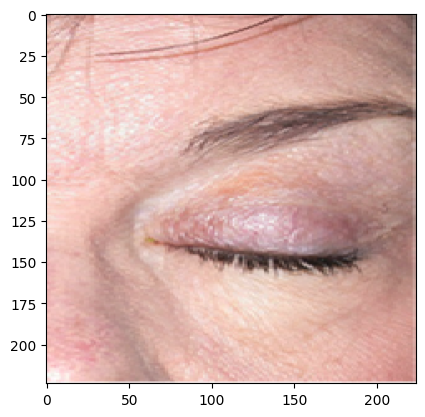

1/1 [==============================] - 0s 316ms/step
102
Predicted Class: Normal
Prediction Confidence: 1.0
Image Path testing\normal\IMG_4593.jpg


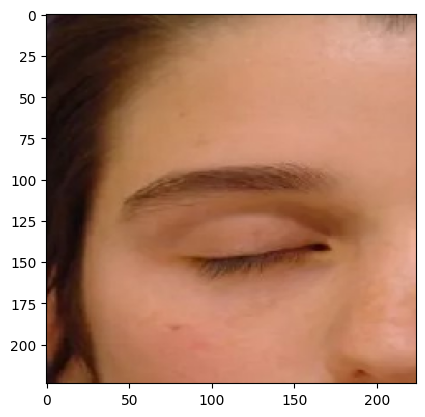

1/1 [==============================] - 0s 166ms/step
103
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0005350143183022738
Image Path testing\normal\IMG_4993.jpg


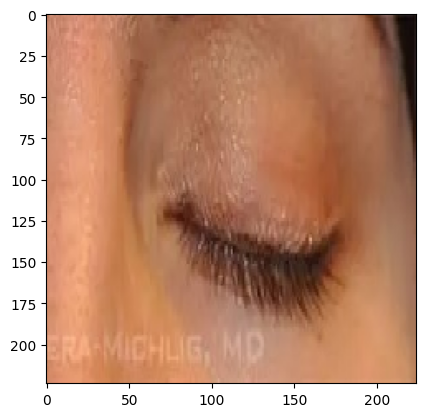

1/1 [==============================] - 0s 149ms/step
104
Predicted Class: Normal
Prediction Confidence: 0.9990811944007874
Image Path testing\normal\IMG_5170.jpg


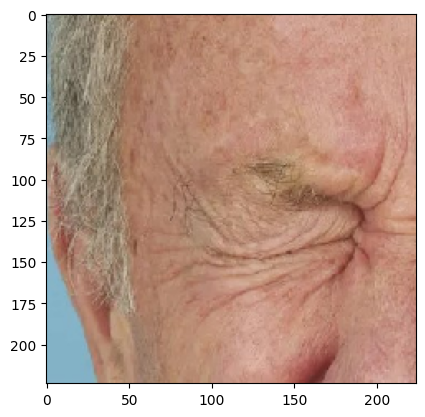

1/1 [==============================] - 0s 216ms/step
105
Predicted Class: Normal
Prediction Confidence: 0.9999709725379944
Image Path testing\normal\IMG_5213.PNG


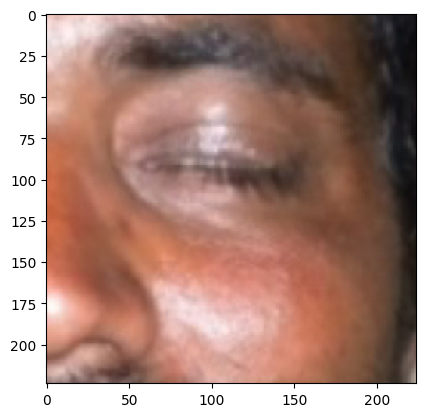

1/1 [==============================] - 0s 159ms/step
106
Predicted Class: Lagophthalmos
Prediction Confidence: 4.735755396723107e-07
Image Path testing\normal\IMG_5214.PNG


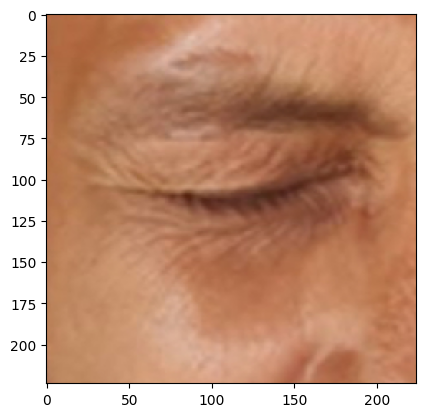

1/1 [==============================] - 0s 268ms/step
107
Predicted Class: Normal
Prediction Confidence: 0.9999104738235474
Image Path testing\normal\IMG_5217.PNG


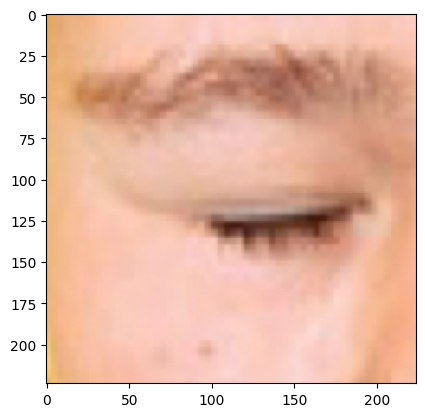

1/1 [==============================] - 0s 225ms/step
108
Predicted Class: Normal
Prediction Confidence: 0.9506186842918396
Image Path testing\normal\IMG_5220.PNG


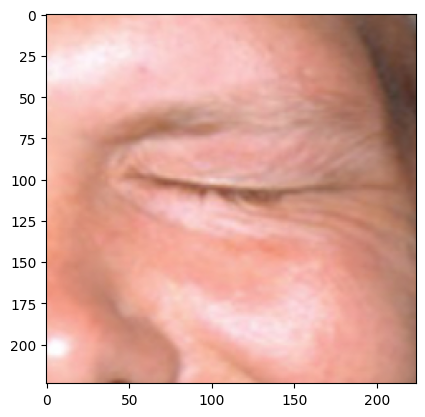

1/1 [==============================] - 0s 234ms/step
109
Predicted Class: Normal
Prediction Confidence: 0.9770305752754211
Image Path testing\normal\IMG_5222.PNG


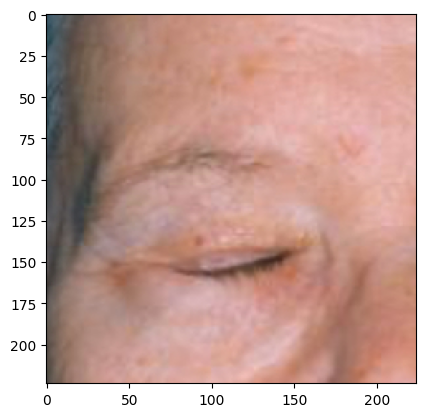

1/1 [==============================] - 0s 221ms/step
110
Predicted Class: Normal
Prediction Confidence: 0.9341369271278381
Image Path testing\normal\IMG_5223.PNG


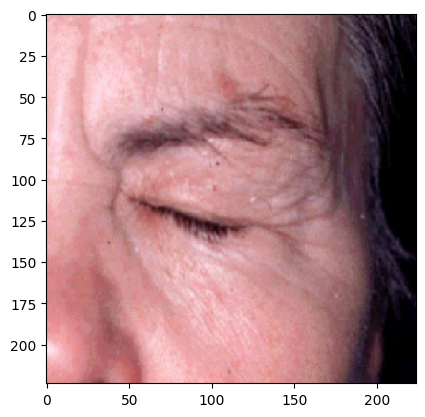

1/1 [==============================] - 0s 266ms/step
111
Predicted Class: Lagophthalmos
Prediction Confidence: 1.444978749987058e-07
Image Path testing\normal\IMG_5224.PNG


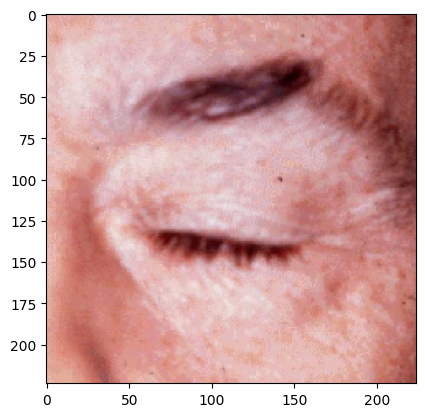

1/1 [==============================] - 0s 228ms/step
112
Predicted Class: Lagophthalmos
Prediction Confidence: 0.23221120238304138
Image Path testing\normal\IMG_5225.PNG


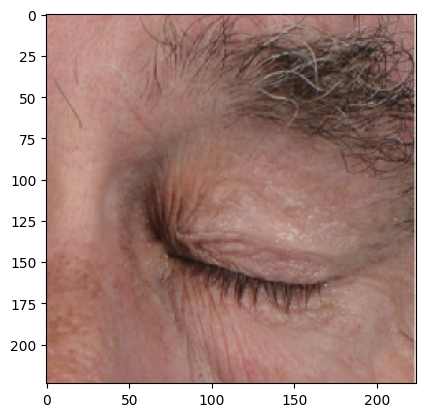

1/1 [==============================] - 0s 345ms/step
113
Predicted Class: Normal
Prediction Confidence: 0.9999998807907104
Image Path testing\normal\IMG_5225_1.PNG


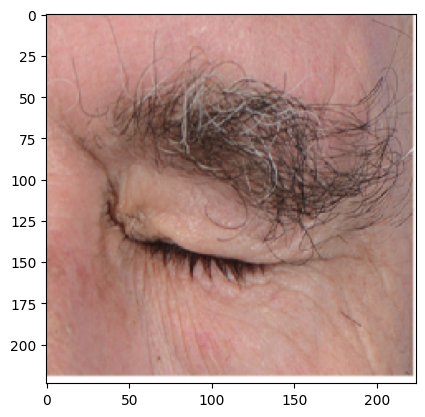

1/1 [==============================] - 0s 261ms/step
114
Predicted Class: Normal
Prediction Confidence: 0.999997615814209
Image Path testing\normal\IMG_5226.PNG


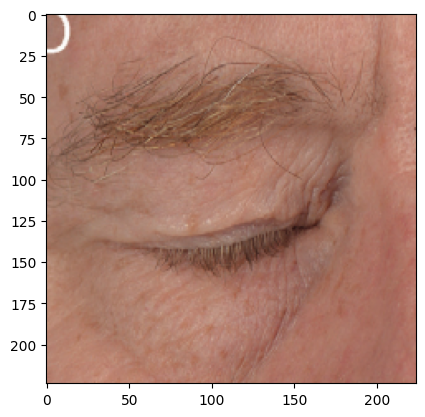

1/1 [==============================] - 0s 224ms/step
115
Predicted Class: Normal
Prediction Confidence: 0.9999999403953552
Image Path testing\normal\IMG_5233.JPG


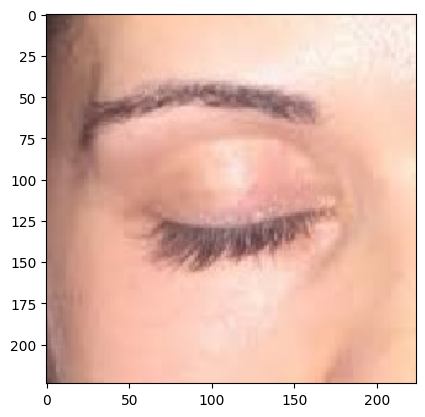

1/1 [==============================] - 0s 183ms/step
116
Predicted Class: Lagophthalmos
Prediction Confidence: 0.00015584898937959224
Image Path testing\normal\IMG_5236.jpeg


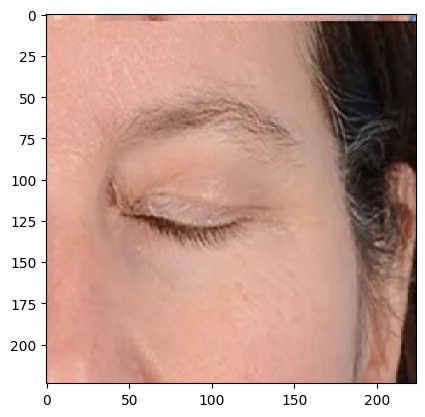

1/1 [==============================] - 0s 214ms/step
117
Predicted Class: Lagophthalmos
Prediction Confidence: 0.03732020780444145
Image Path testing\normal\IMG_5236_1.jpeg


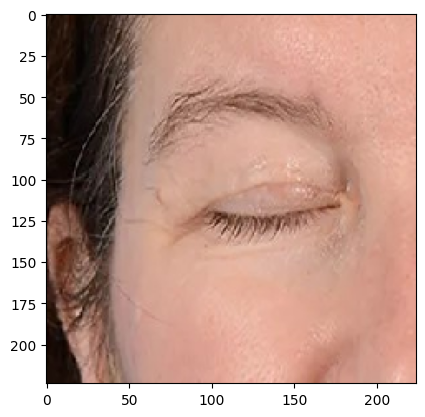

1/1 [==============================] - 0s 272ms/step
118
Predicted Class: Lagophthalmos
Prediction Confidence: 9.270919321124893e-08
Image Path testing\normal\IMG_5237.JPG


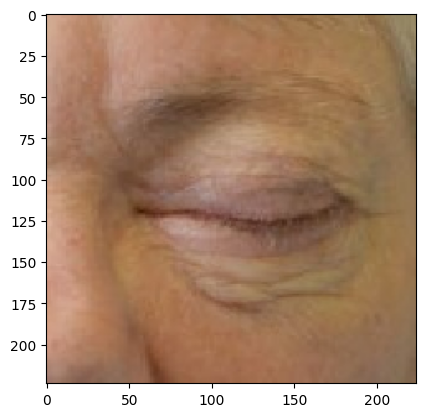

1/1 [==============================] - 0s 267ms/step
119
Predicted Class: Normal
Prediction Confidence: 0.9983617067337036
Image Path testing\normal\IMG_5241.PNG


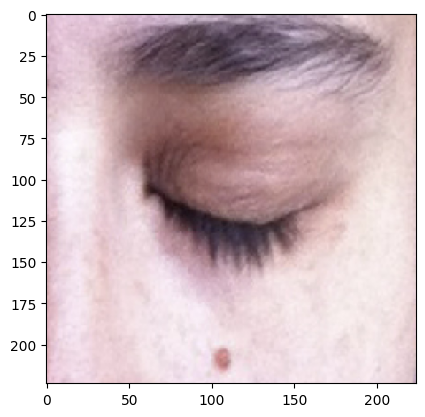

1/1 [==============================] - 0s 250ms/step
120
Predicted Class: Lagophthalmos
Prediction Confidence: 0.0021479863207787275
Image Path testing\normal\IMG_5248.PNG


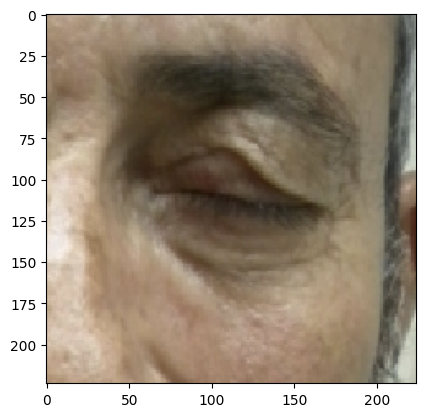

1/1 [==============================] - 0s 216ms/step
121
Predicted Class: Normal
Prediction Confidence: 0.997360348701477
Image Path testing\normal\IMG_5249.JPG


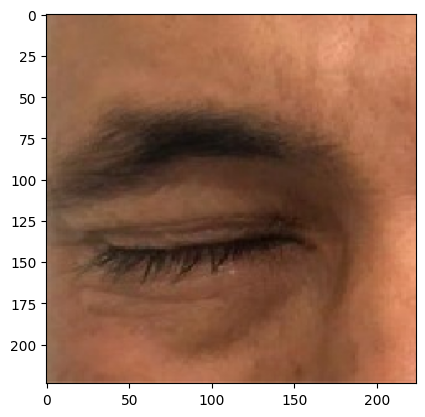

1/1 [==============================] - 0s 265ms/step
122
Predicted Class: Normal
Prediction Confidence: 0.9999963641166687
Image Path testing\normal\test1_normal.jpeg


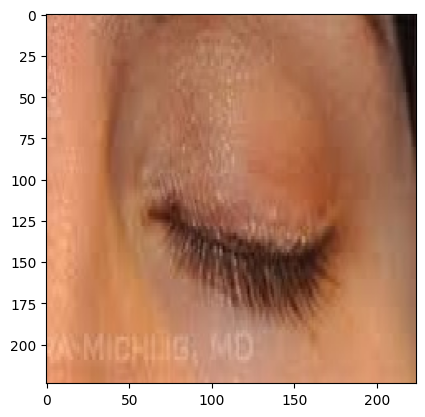

1/1 [==============================] - 0s 315ms/step
123
Predicted Class: Normal
Prediction Confidence: 0.9965109825134277
Image Path testing\normal\test3_normal.jpg


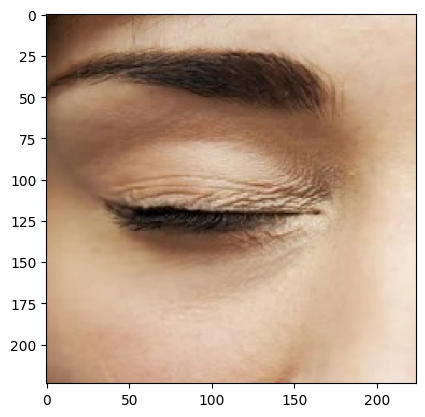

1/1 [==============================] - 0s 176ms/step
124
Predicted Class: Normal
Prediction Confidence: 0.9978890419006348
Image Path testing\normal\test4_closed.jpeg


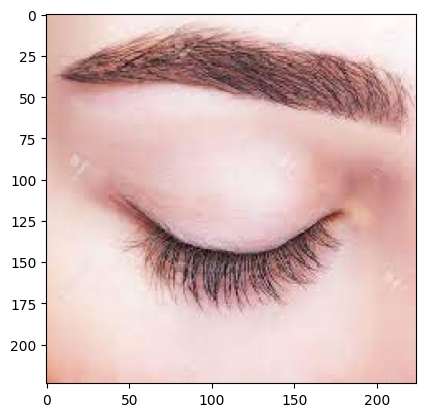

1/1 [==============================] - 0s 299ms/step
125
Predicted Class: Normal
Prediction Confidence: 0.999992847442627
Image Path testing\normal\test4_closed.jpg


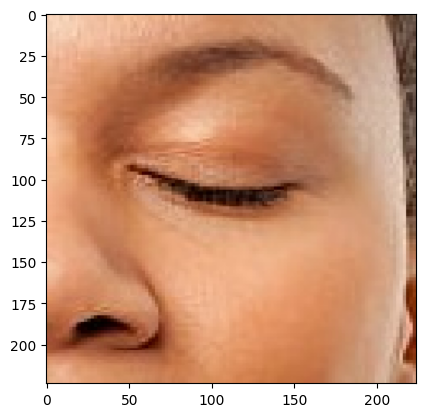

1/1 [==============================] - 0s 166ms/step
126
Predicted Class: Lagophthalmos
Prediction Confidence: 2.5471954359090887e-06
Image Path testing\normal\test5_closed.jpeg


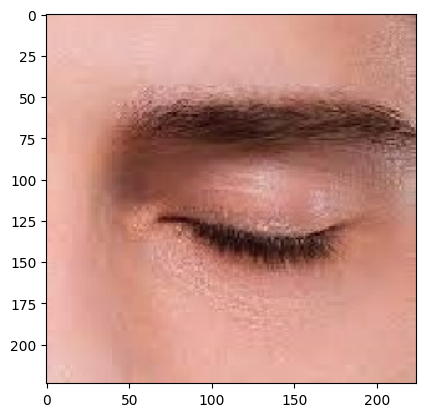

1/1 [==============================] - 0s 201ms/step
127
Predicted Class: Normal
Prediction Confidence: 0.9991761445999146
Image Path testing\normal\test6_closed.jpg


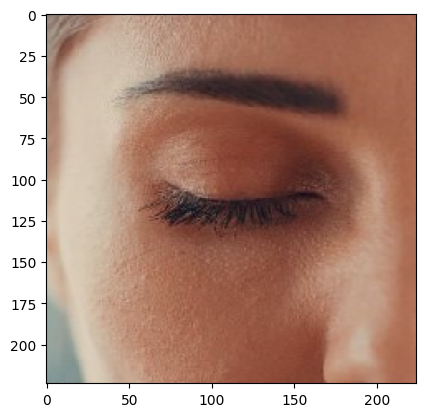

1/1 [==============================] - 0s 282ms/step
128
Predicted Class: Lagophthalmos
Prediction Confidence: 5.087809729076298e-09
Merging complete.


NameError: name 'files' is not defined

In [6]:
import os
import shutil

# Define the main folder and subfolders
main_folder = 'testing'
subfolders = ['lagophthalmos', 'normal']
y_pred = []
results_with_images = {}
i = 0
# Loop through each subfolder
for subfolder in subfolders:
    subfolder_path = os.path.join(main_folder, subfolder)
    
    # Check if the subfolder exists
    if os.path.exists(subfolder_path) and os.path.isdir(subfolder_path):
        
        # Loop through each file in the subfolder
        for file_name in os.listdir(subfolder_path):
            source = os.path.join(subfolder_path, file_name)
            results_with_images[i] = []
            print('Image Path' , source)
            prediction, img_array = run_inference(model_final_loaded, source)
            print(i)
            # Interpret the prediction
            if prediction[0][0] < 0.5:
                results_with_images[i].append([img_array, '0'])

                y_pred.extend([0])
                print('Predicted Class: Lagophthalmos')
            else:
                results_with_images[i].append([img_array, '1'])
                y_pred.extend([1])
                print('Predicted Class: Normal')

            i += 1
            print(f'Prediction Confidence: {prediction[0][0]}')
    else:
        print(f"Subfolder {subfolder} does not exist or is not a directory.")

print("Merging complete.")

In [ ]:
import os
# Example usage
y_pred = []
results_with_images = {}
for i, f in enumerate(files):
    results_with_images[i] = []
    img_path = f # Path to your image
    print('Image Path' , img_path)
    prediction, img_array = run_inference(loaded_model, img_path)
    print(i)
    # Interpret the prediction
    if prediction[0][0] < 0.5:
        results_with_images[i].append([img_array, '0'])

        y_pred.extend([0])
        print('Predicted Class: Lagophthalmos')
    else:
        results_with_images[i].append([img_array, '1'])
        y_pred.extend([1])
        print('Predicted Class: Normal')

    print(f'Prediction Confidence: {prediction[0][0]}')

In [1]:
import tensorflow as tf

2024-07-12 12:58:46.573573: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:479] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-12 12:58:46.597042: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:10575] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-12 12:58:46.597086: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1442] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-12 12:58:46.612102: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
print(tf.test.is_gpu_available())

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
True


2024-07-12 12:58:59.236075: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1928] Created device /device:GPU:0 with 10364 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3060, pci bus id: 0000:05:00.0, compute capability: 8.6


In [3]:
tf.__version__

'2.16.2'

In [4]:
from tensorflow.keras.models import load_model
import efficientnet.keras as efn
# base_model = efn.EfficientNetB0(input_shape = (224, 224, 3), include_top = False, weights = 'imagenet')

# Load the model
model_final_loaded = load_model('keras_model.h5')

TypeError: Object of type function is not JSON serializable

In [4]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.models import Model

# Define the input shape
input_shape = (100,)  # for example, if your input has 100 features

# Create the input layer
inputs = Input(shape=input_shape)

# Add some layers (this is just an example)
x = Dense(64, activation='relu')(inputs)
x = Dense(32, activation='relu')(x)

# Add the final layer with sigmoid activation
predictions = Dense(1, activation='sigmoid')(x)

# Create the model
model = Model(inputs=inputs, outputs=predictions)

2024-07-12 13:17:13.915018: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1928] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 2048 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3060, pci bus id: 0000:05:00.0, compute capability: 8.6


In [9]:
!nvidia-smi

Fri Jul 12 13:15:13 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.67                 Driver Version: 550.67         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3060        On  |   00000000:05:00.0 Off |                  N/A |
|  0%   34C    P8             14W /  170W |   11907MiB /  12288MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
import tensorflow as tf

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Limit GPU to 2 GB memory
        tf.config.set_logical_device_configuration(
            gpus[0],
            [tf.config.LogicalDeviceConfiguration(memory_limit=2048)]
        )
    except RuntimeError as e:
        print(e)

2024-07-12 13:16:27.600499: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:479] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-12 13:16:27.624206: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:10575] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-12 13:16:27.624233: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1442] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-12 13:16:27.639076: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
!nvidia-smi

Fri Jul 12 13:16:30 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.67                 Driver Version: 550.67         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3060        On  |   00000000:05:00.0 Off |                  N/A |
|  0%   34C    P8             14W /  170W |      31MiB /  12288MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----